# this notebook extracts a lot of data from plate models and plots them

In [41]:
import sys
sys.path.insert(1, '/Users/Andrew/Documents/PhD/Scripts/Python/pygplates_rev13')
import pygplates
import points_in_polygons
import numpy as np
import pandas as pd
import pickle
import os
from mpl_toolkits.basemap import Basemap, shiftgrid
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
from create_gpml import create_gpml_regular_long_lat_mesh
from skimage import measure
%matplotlib inline

In [23]:
#load files

basedir = '/Users/Andrew/Documents/PhD/Models'  #set basedir for load
basedir_save = '/Users/Andrew/Documents/PhD/Scripts/Scripts_Output/Python/2017_Rift_SZ_length/' #set basedir for saving

#load COB files
COBterrane_file_410_0 = '%s/Matthews-410-0Ma/StaticGeometries/AgeGridInput/Global_EarthByte_GeeK07_COB_Terranes_Matthews_etal_EDITED.gpml' % basedir
COBterrane_file_1000_410 = '%s/1000-410_Models/COBs_global_artificial_individual.gpml' % basedir

#load Neoproterozoic Rifts
input_rifts_with_modelled_additions_failed_rifts = '%s/1000-410_Models/Rifts/Rifts_with_modelled_additions_failed_rifts_PLOTTING.gpml' % basedir

#load younger rifts
input_phanerozoic_rifts = '/Users/Andrew/Documents/PhD/Scripts/Python_Scripts/PyGplates_functions/Arc_rift_length_extraction/output_polylines.gpml'

#load polygon files
craton_file_1000_410 = '%s/1000-410_Models/Topos_for_plotting/Neoproterozoic_Palaeozoic_Shapes_20170714_new-antarctica.gpml' % basedir
craton_file_410_0 = '%s/Matthews-410-0Ma/StaticGeometries/Coastlines/Global_coastlines_2015_v1_low_res.gpml' % basedir

#load rotation files
rotation_file_410_250 = '%s/Matthews-410-0Ma/Global_EB_410-250Ma_GK07_Matthews_etal.rot' % basedir
rotation_file_250_0 = '%s/Matthews-410-0Ma/Global_EB_250-0Ma_GK07_Matthews_etal.rot' % basedir
rotation_file_1000_410 = '%s/1000-410_Models/Topos_for_plotting/1000-410_rotations(finished)_20170621a_north_china-tarim-aus.rot' % basedir

#load topologies
topologies = ['%s/1000-410_Models/Topos_for_plotting/Convergence_20170716.gpml' %basedir,
              '%s/1000-410_Models/Topos_for_plotting/Divergence_20170622.gpml' %basedir,
              '%s/1000-410_Models/Topos_for_plotting/Transforms_20170716.gpml' %basedir,
              '%s/1000-410_Models/Topos_for_plotting/Topologies_20170716.gpml' %basedir]


topologies2 = ['%s/Matthews-410-0Ma/Global_EarthByte_Paleozoic_plate_boundaries_Matthews_etal.gpml' % basedir]

topologies3 = ['%s/Matthews-410-0Ma/Global_EarthByte_Mesozoic-Cenozoic_plate_boundaries_Matthews_etal.gpml' % basedir]

#generate pygplates files for Mer17+Dom16 models
cobter_1000_410 = pygplates.FeatureCollection(COBterrane_file_1000_410)
rotation_model_1000_410 = pygplates.RotationModel(rotation_file_1000_410)
rifts = pygplates.FeatureCollection(input_rifts_with_modelled_additions_failed_rifts)
rifts_phanerozoic = pygplates.FeatureCollection(input_phanerozoic_rifts)
cratons_1000_410 = pygplates.FeatureCollection(craton_file_1000_410)

#generate pygpltaes file for Mat16 models
cobter_410_0 = pygplates.FeatureCollection(COBterrane_file_410_0)
rotation_model_410_250 = pygplates.RotationModel(rotation_file_410_250)
rotation_model_250_0 = pygplates.RotationModel(rotation_file_250_0)
cratons_410_0 = pygplates.FeatureCollection(craton_file_410_0)

#generate points for creating supercontinent polygons
multipoints = create_gpml_regular_long_lat_mesh(1)

for multipoint in multipoints:
    for mp in multipoint.get_all_geometries():
        points = mp.to_lat_lon_point_list()

#set date line wrapper for plotting maps
date_line_wrapper_crat = pygplates.DateLineWrapper()

In [24]:
#create supercontinent polygons
polygons = []
for feature in cobter_410_0:
    
    for geom in feature.get_geometries():
        polygon = []
        #print feature.get_geometry()
    
        polygon = feature
        polygon.set_geometry(pygplates.PolygonOnSphere(geom))

        #print polygon.get_geometry()

        polygons.append(polygon)

cobter_410_0 = pygplates.FeatureCollection(polygons)
#fc.write('pltest.gpmlz')
#
polygons = []
for feature in cobter_1000_410:
    
    for geom in feature.get_geometries():
        polygon = []
        #print feature.get_geometry()
    
        polygon = feature
        polygon.set_geometry(pygplates.PolygonOnSphere(geom))

        #print polygon.get_geometry()

        polygons.append(polygon)

cobter_1000_410 = pygplates.FeatureCollection(polygons)
#fc.write('pltest.gpmlz')

In [25]:
#this function creates new polygons that are the amalgamation of a series of overlapping polygons
#in order to make 'supercontinent polyogns'
def run_grid_pip(time,points,polygons,rotation_model):
    
    reconstructed_polygons = []
    pygplates.reconstruct(polygons,rotation_model,reconstructed_polygons,time)
    
    rpolygons = []
    for polygon in reconstructed_polygons:
        #print polygon
        #if polygon.get_reconstructed_geometry() == 'PolygonOnSphere':
        if polygon.get_reconstructed_geometry():
            #print polygon.get_reconstructed_geometry()
            rpolygons.append(polygon.get_reconstructed_geometry())


    polygons_containing_points = points_in_polygons.find_polygons(points, rpolygons)

    lat = []
    lon = []
    zval = []
    
    for pcp,point in zip(polygons_containing_points,points):
        lat.append(point.get_latitude())
        lon.append(point.get_longitude())
        if pcp is not None:
            zval.append(1)
        else:
            zval.append(0)
            
    bi = np.array(zval).reshape(181,361)
    
    return bi

260
270
280
290
300
310
320
330
340
350
360
370
380
390
400
410


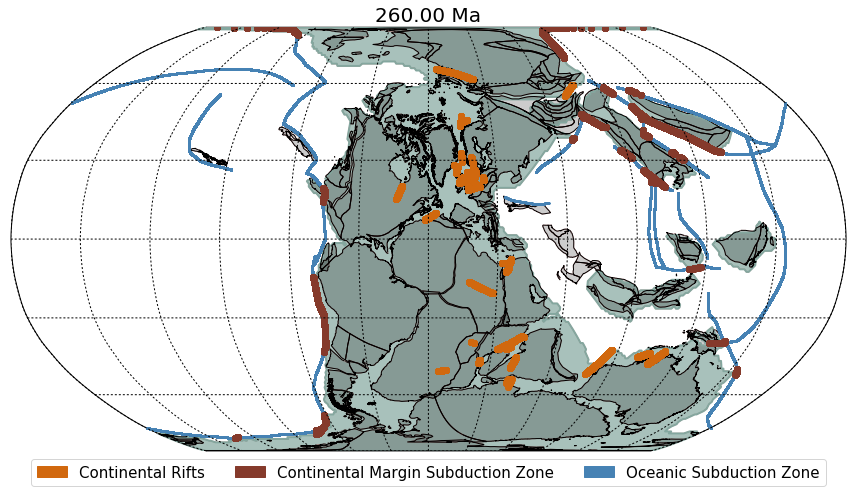

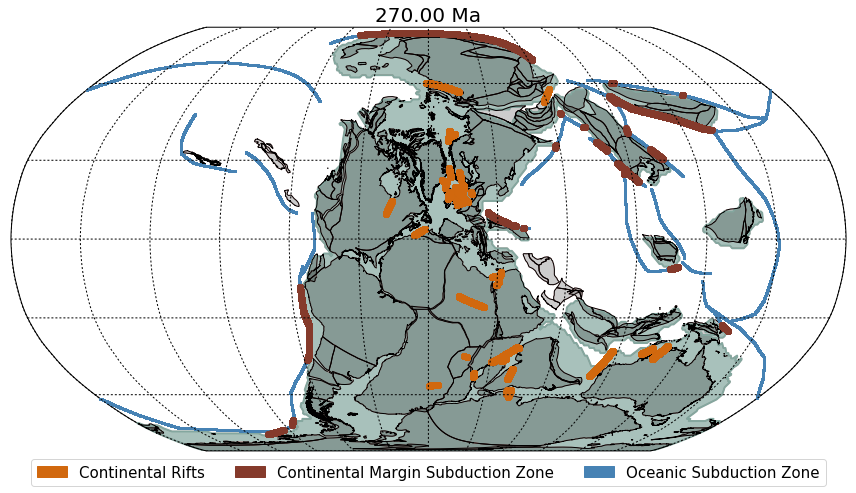

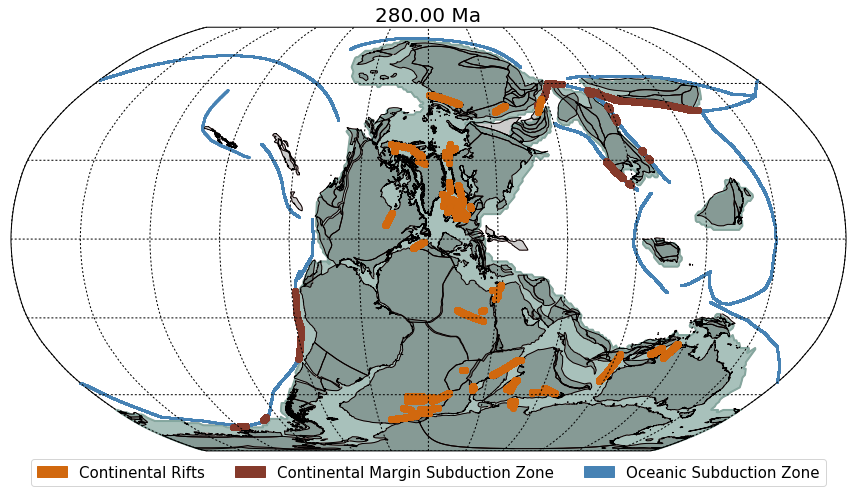

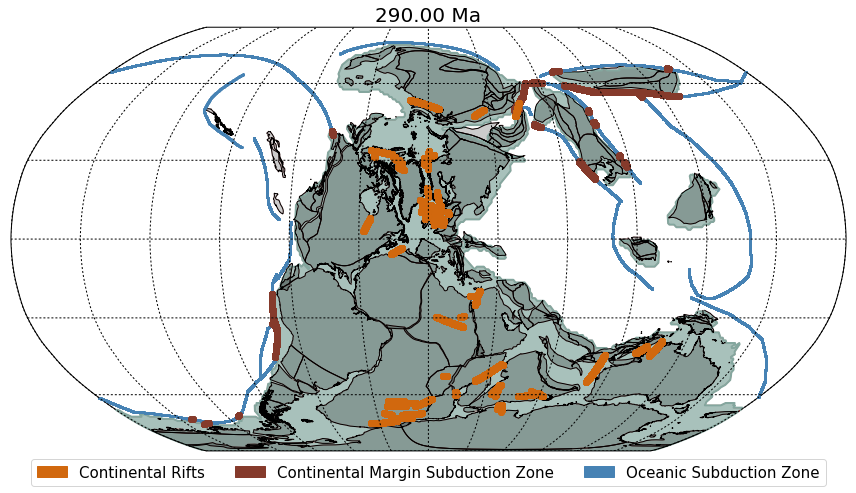

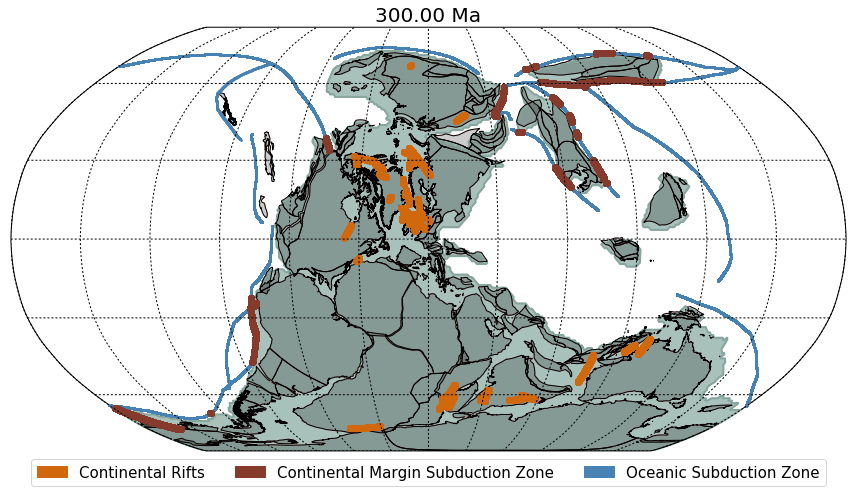

...

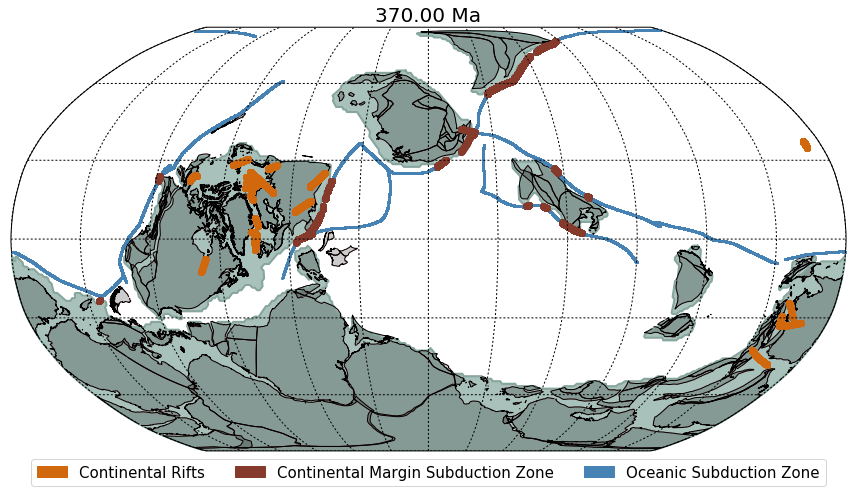

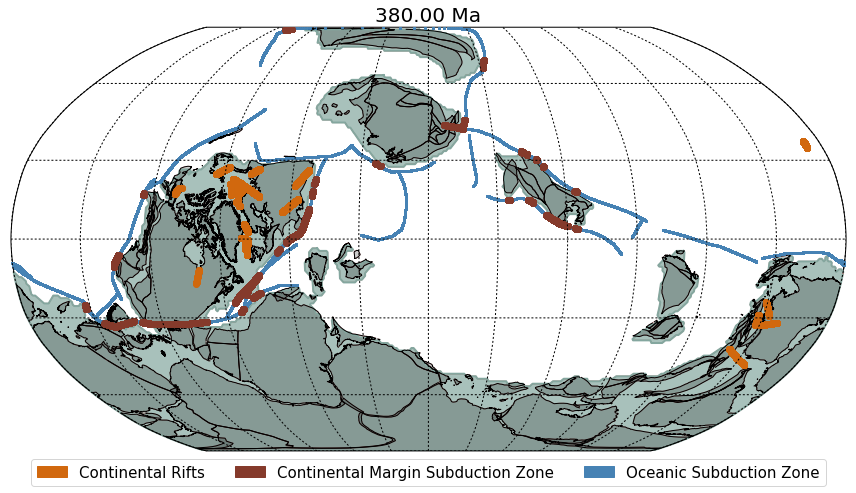

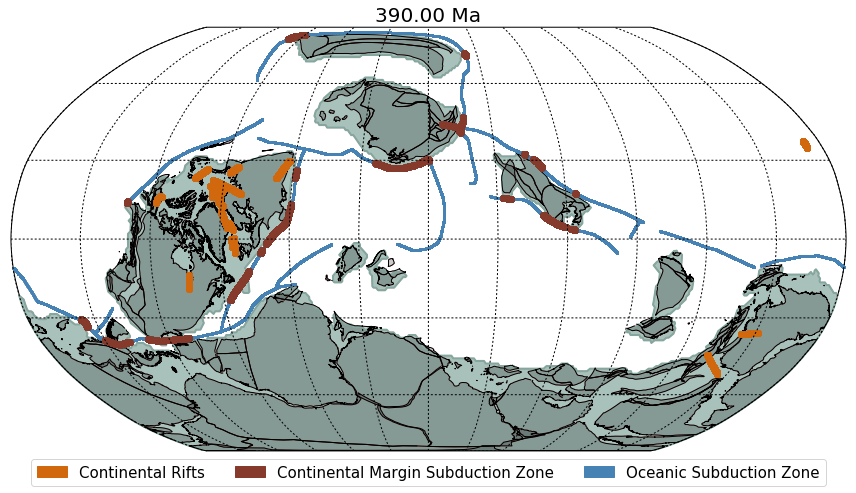

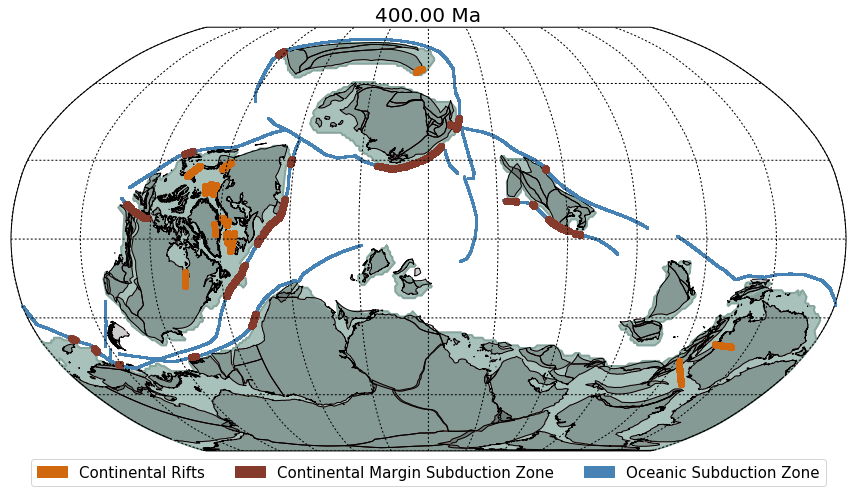

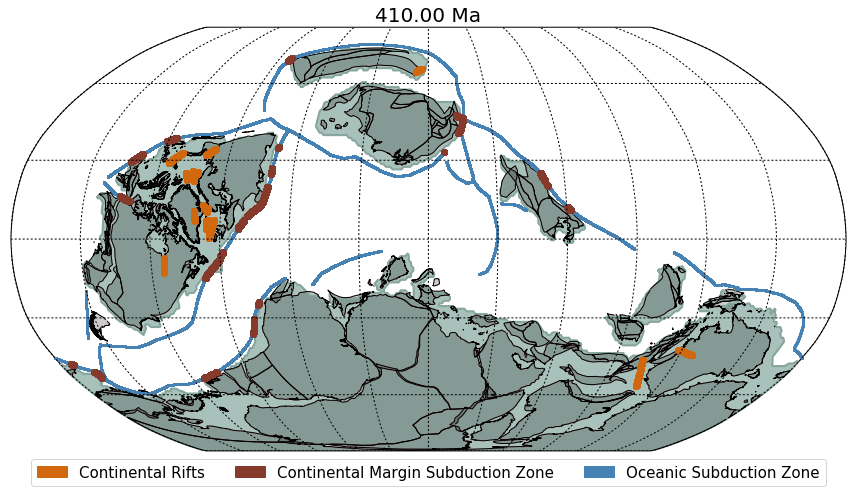

In [75]:
#extract and plot data for 410-250
date_line_wrapper = pygplates.DateLineWrapper() #dateline wrapper for plotting
cobter_feature_collection = []  #empty list for our polygons for analysis at the end

for i,time in enumerate(np.arange(260,420,10)):  #set time
    print time
    resolved_topologies = []
    shared_boundary_sections = []
    all_tesselated_shared_sub_segment = []
    continental_arcs = []
    reconstructed_COBs = []
    reconstructed_rifts = []
    reconstructed_cratons = []
    
    #resolve/reconstruct our topologies, rifts, supercontinents etc. at the desired time
    pygplates.resolve_topologies(topologies2, rotation_model_410_250, resolved_topologies, time, shared_boundary_sections)
    pygplates.reconstruct(cobter_410_0, rotation_model_410_250, reconstructed_COBs, time)
    pygplates.reconstruct(rifts_phanerozoic, rotation_model_410_250, reconstructed_rifts, time)
    pygplates.reconstruct(cratons_410_0, rotation_model_410_250, reconstructed_cratons, time)
    
    bi = run_grid_pip(time,points,cobter_410_0,rotation_model_410_250)
    
    contours = measure.find_contours(bi, .5)
    
    #there is a problem occassionaly when creating supercontinent polygons where pygplates
    #doesn't know what is inside and what is outside
    #this occurs when a supercontinent covers a pole
    #these lines pad the supercontinent calculation to prevent this
    pad_hor = np.zeros((1,361))
    pad_ver = np.zeros((182,1))
    pad1 = np.vstack((bi,pad_hor))
    pad2 = np.hstack((pad_ver,pad1))
    pad3 = np.hstack((pad2,pad_ver))
    contours = measure.find_contours(pad3, 0.5, fully_connected='low')

    contour_polygons = []
    cobter_feature_collection = []
    for n,cp in enumerate(contours):
        #these lines undo the padding (i promise, but if in doubt you can output to a gplates file
        #or print the image)
        cp[:,1] = cp[:,1]-1
        cp[:,0] = cp[:,0]-1

        cp[np.where(cp[:,0]<0.),0] = 0
        cp[np.where(cp[:,0]>180.),0] = 180
        cp[np.where(cp[:,1]<0.),1] = 0
        cp[np.where(cp[:,1]>360.),1] = 360
        cpf = pygplates.PolygonOnSphere(zip(cp[:,0]-90,cp[:,1]-180))
        contour_polygons.append(cpf)
        cobter_feature_collection.append(cpf)
    
    #set basemape for plotting reconstructions
    fig = plt.figure(figsize=(12,8))
    m1 = Basemap(resolution='c',projection='robin',lon_0=0.)
    clip_path = m1.drawmapboundary()
    m1.drawmeridians(np.arange(0, 360, 30),labels=[0,0,0,0], fontsize=10)
    m1.drawparallels(np.arange(-90, 90, 30), labels=[0,0,0,0], fontsize=10)
    ax = plt.gca()
    
    area_threshold = 1250000 #area threshold to determine the min size of continents
    plate_area = [] #extract plate area
    for pg in contour_polygons:
        if pg.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
            plate_area.append(pg.get_area()*pygplates.Earth.mean_radius_in_kms**2)
            wrapped_polygons_lat = []
            wrapped_polygons_lon = []
            wrapped_polygons = date_line_wrapper.wrap(pg, 1)
            for wrapped_polygon in wrapped_polygons:
                for wrapped_point in wrapped_polygon.get_exterior_points():
                    wrapped_point_lat_lon = wrapped_point.get_latitude(), wrapped_point.get_longitude()
                    wrapped_polygons_lat.append(wrapped_point.get_latitude())
                    wrapped_polygons_lon.append(wrapped_point.get_longitude())
            
            x_geom, y_geom = m1(wrapped_polygons_lon, wrapped_polygons_lat)
            m1.plot(x_geom, y_geom, '#84a79f', linewidth=2,zorder=0)
            plt.fill(x_geom, y_geom, '#84a79f', edgecolor='r', fill=True, alpha=0.7,zorder=0)
            
    for crat in reconstructed_cratons:
        crat_geom = pygplates.PolygonOnSphere(crat.get_reconstructed_geometry())
        wrapped_cratons = date_line_wrapper.wrap(crat_geom, 1)
        for wrapped_craton in wrapped_cratons:
            wrapped_cratons_lat = []
            wrapped_cratons_lon = []
            for wrapped_craton_point in wrapped_craton.get_exterior_points():
                wrapped_craton_lat_lon = wrapped_craton_point.get_latitude(), wrapped_craton_point.get_longitude()
                wrapped_cratons_lat.append(wrapped_craton_point.get_latitude())
                wrapped_cratons_lon.append(wrapped_craton_point.get_longitude())

            x_geom_crat, y_geom_crat = m1(wrapped_cratons_lon, wrapped_cratons_lat)
            m1.plot(x_geom_crat, y_geom_crat, 'k', linewidth=1,zorder=0)
            plt.fill(x_geom_crat, y_geom_crat, 'k', edgecolor='r', fill=True, alpha=0.2,zorder=0)


    # Proximity Test
    #we extact continents above and below our distance threshold to show what *isn't* considered
    #continent-margin arc
    sz_lons = []
    sz_lats = []
    sz_lons_non = []
    sz_lats_non = []
    distance_kms = 100
    distance_threshold_radians = distance_kms/pygplates.Earth.mean_radius_in_kms
    
    for shared_boundary_section in shared_boundary_sections:

        if shared_boundary_section.get_feature().get_feature_type() == pygplates.FeatureType.gpml_subduction_zone:

            for shared_sub_segment in shared_boundary_section.get_shared_sub_segments():
                tmp = shared_sub_segment.get_resolved_geometry()
                tesselated_shared_sub_segment = tmp.to_tessellated(np.radians(0.1))      

                all_tesselated_shared_sub_segment.append(tesselated_shared_sub_segment)
                count = 0
                for segment in tesselated_shared_sub_segment.get_segments():
                    
                    for pg2 in contour_polygons:

                        if pg2.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
                    
                            pg3 = pg2
                        
                            distance_radians = pygplates.GeometryOnSphere.distance(segment.get_arc_point(0.5), 
                                                                                   pg3,
                                                                                   distance_threshold_radians,
                                                                                   geometry2_is_solid=True)
                            #print count, distance_radians
                            
                            
                            
                            if distance_radians is not None:

                                sz_lons.append(segment.get_arc_point(0.5).to_lat_lon()[1])
                                sz_lats.append(segment.get_arc_point(0.5).to_lat_lon()[0])
                                #break
                                
                            if distance_radians is None:
                                sz_lons_non.append(segment.get_arc_point(0.5).to_lat_lon()[1])
                                sz_lats_non.append(segment.get_arc_point(0.5).to_lat_lon()[0])
                                #break

                            count += 1
                            
               
                sz_lons_plot_non,sz_lats_plot_non = m1(sz_lons_non,sz_lats_non)
                m1.scatter(sz_lons_plot_non,sz_lats_plot_non, color='#4682b4', s=1)
                            
                sz_lons_plot,sz_lats_plot = m1(sz_lons,sz_lats)
                m1.scatter(sz_lons_plot,sz_lats_plot, color='#853a2b')                
            
              
    rift_points = []
    rift_lats = []
    rift_lons = [] 
    for rift in reconstructed_rifts:
        if (rift.get_feature().get_valid_time()[0] > time) and (time > int(rift.get_feature().get_valid_time()[1]) ):
            rift_polyline = rift.get_reconstructed_geometry()
            tmp1 = rift_polyline.to_tessellated(np.radians(0.1))
            for rift_seg in tmp1.get_segments():
                rift_lons.append(rift_seg.get_arc_point(0.5).to_lat_lon()[1])
                rift_lats.append(rift_seg.get_arc_point(0.5).to_lat_lon()[0])
            x_rift,y_rift = m1(rift_lons,rift_lats)
            m1.scatter(x_rift,y_rift,color='#d1680e')#, linewidth=3)
            rift_points.append(tmp1.to_lat_lon_list())
           
    cont_rift = mpatches.Patch(color='#d1680e', label='Continental Rifts')
    cont_sz = mpatches.Patch(color='#853a2b', label='Continental Margin Subduction Zone')
    oceanic_sz = mpatches.Patch(color='#4682b4', label='Oceanic Subduction Zone')
        
    #plot maps with titles 
    plt.title('%0.2f Ma' % (time), fontsize=20)
    plt.tight_layout()
    plt.legend(loc='lower center', ncol=3, bbox_to_anchor=(0.5,-0.1), handles=[cont_rift, cont_sz, oceanic_sz], fontsize=15)

    
#assigned_point_feature_collection = pygplates.FeatureCollection(contour_polygons)
#assigned_point_feature_collection.write(contour_polygons)

    #Check for existing output directory and create it if not found
    if not os.path.exists('%s/output1/snapshots' % basedir_save):
        os.makedirs('%s/output1/snapshots' % basedir_save)

    #Check for existing output file with same name and remove if found
    if os.path.isfile('%soutput1/snapshots/%s' % (basedir_save, time)):
        os.remove('%soutput1/snapshots/%s' % (basedir_save, time))
        
    plt.savefig('%soutput1/snapshots/%s.png' % (basedir_save, time), bbox_inches='tight')

420
430
440
450
460
470
480
490
500
510
520
530
540
550
560
570
580
590
600
610
620


//anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


630
640
650
660
670
680
690
700
710
720
730
740
750
760
770
780
790
800
810
820
830
840
850
860
870
880
890
900
910
920
930
940
950
960
970
980
990
1000


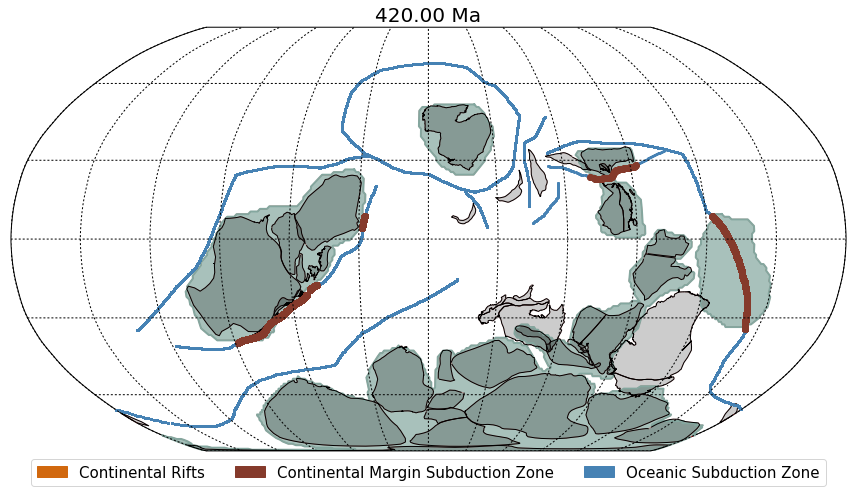

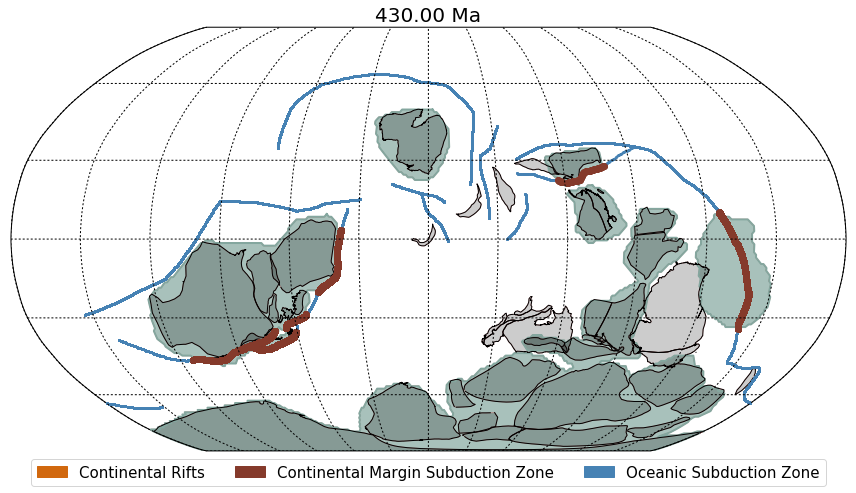

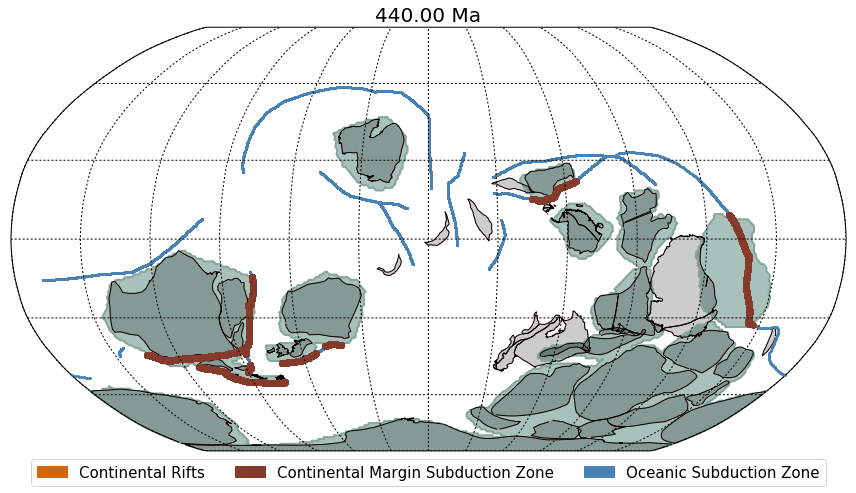

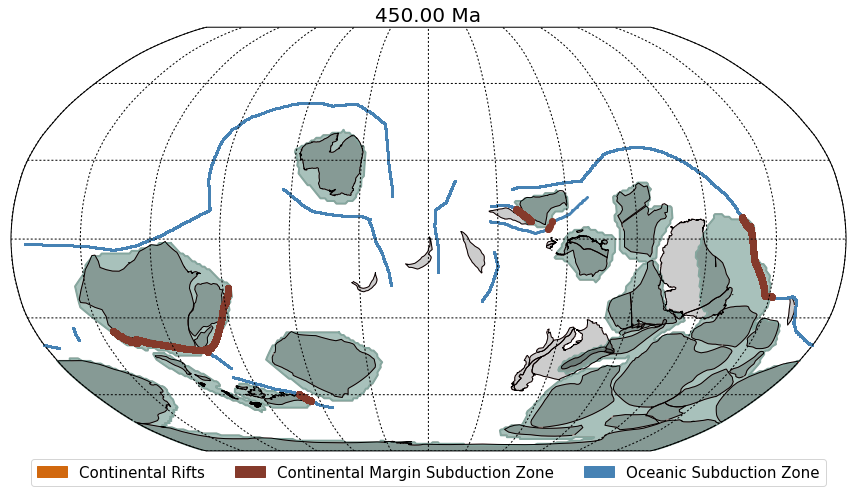

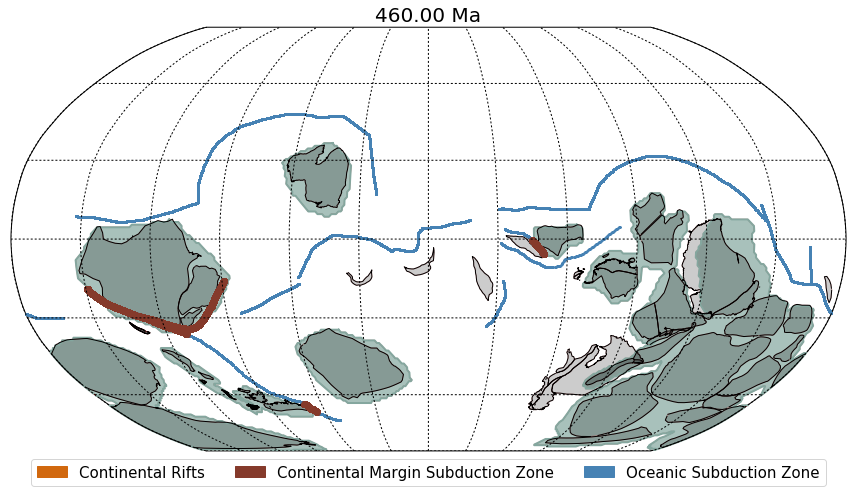

...

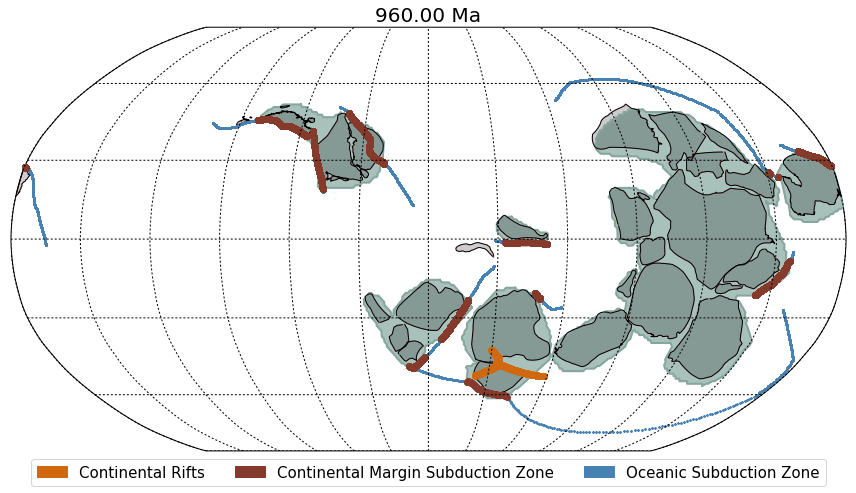

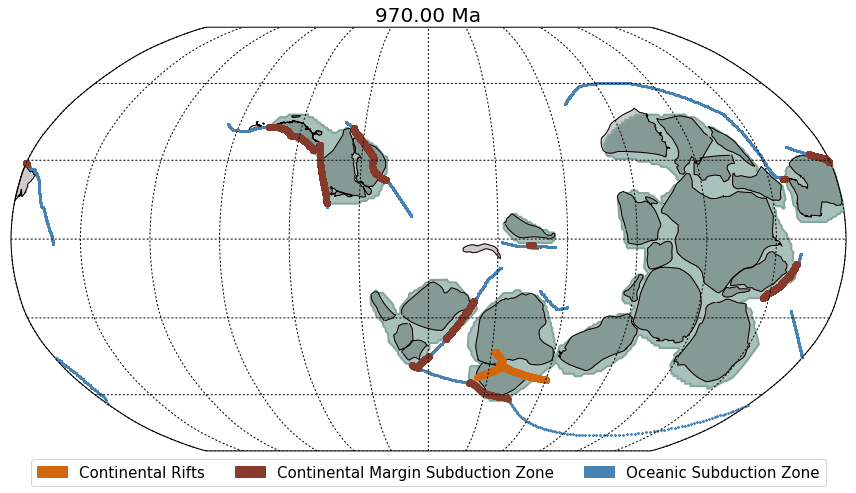

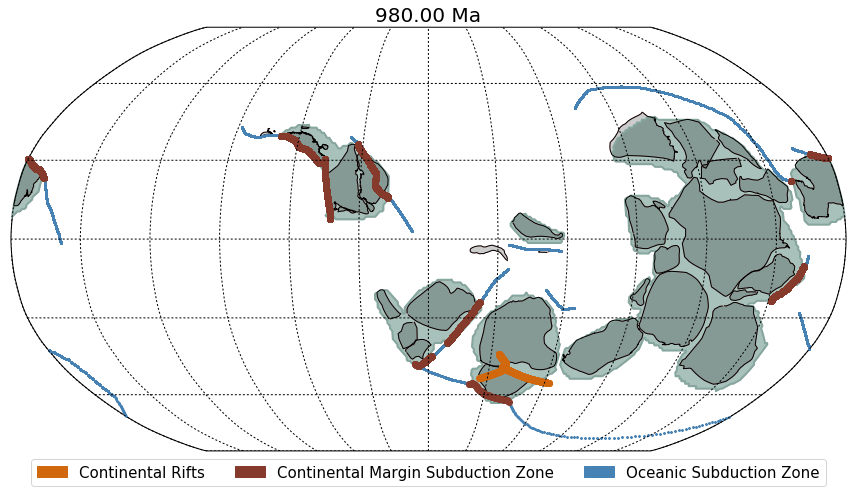

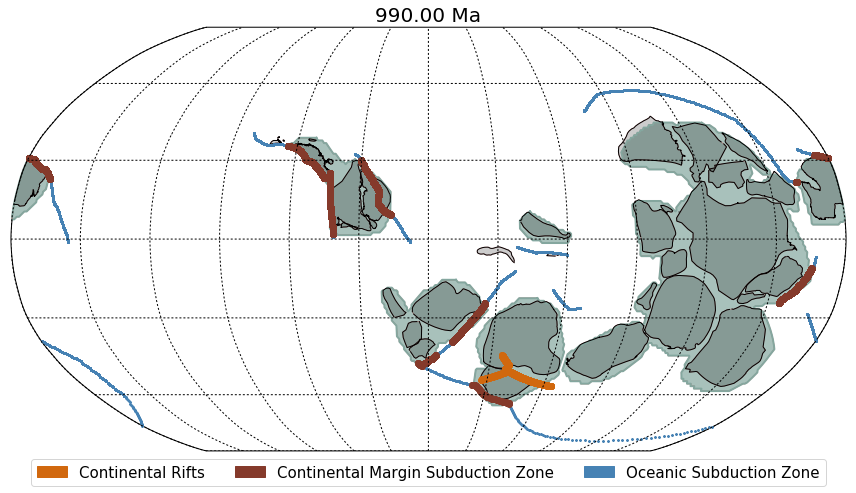

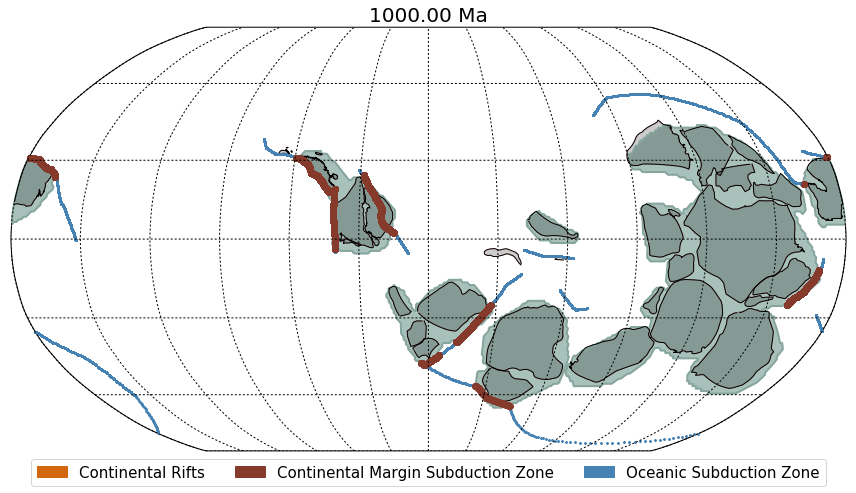

In [76]:
#extract data for 1000-410
date_line_wrapper = pygplates.DateLineWrapper()
plate_area = [] 
for i,time in enumerate(np.arange(420,1010,10)):
    print time
    resolved_topologies = []
    shared_boundary_sections = []
    all_tesselated_shared_sub_segment = []
    all_tesselated_shared_sub_segment2 = []
    continental_arcs = []
    reconstructed_COBs = []
    reconstructed_rifts = []
    reconstructed_cratons = []
    
    pygplates.resolve_topologies(topologies, rotation_model_1000_410, resolved_topologies, time, shared_boundary_sections)
    pygplates.reconstruct(cobter_1000_410, rotation_model_1000_410, reconstructed_COBs, time)
    pygplates.reconstruct(rifts, rotation_model_1000_410, reconstructed_rifts, time)
    pygplates.reconstruct(cratons_1000_410, rotation_model_1000_410, reconstructed_cratons, time)
    
    bi = run_grid_pip(time,points,cobter_1000_410,rotation_model_1000_410)
    
    contours = measure.find_contours(bi, .5)
    
    pad_hor = np.zeros((1,361))
    pad_ver = np.zeros((182,1))
    pad1 = np.vstack((bi,pad_hor))
    pad2 = np.hstack((pad_ver,pad1))
    pad3 = np.hstack((pad2,pad_ver))
    contours = measure.find_contours(pad3, 0.5, fully_connected='low')

    contour_polygons = []
    cobter_feature_collection = []
    for n,cp in enumerate(contours):
        cp[:,1] = cp[:,1]-1
        cp[:,0] = cp[:,0]-1

        cp[np.where(cp[:,0]<0.),0] = 0
        cp[np.where(cp[:,0]>180.),0] = 180
        cp[np.where(cp[:,1]<0.),1] = 0
        cp[np.where(cp[:,1]>360.),1] = 360
        cpf = pygplates.PolygonOnSphere(zip(cp[:,0]-90,cp[:,1]-180))
        contour_polygons.append(cpf)
        cobter_feature_collection.append(cpf)
        
    
    fig = plt.figure(figsize=(12,8))
    m1 = Basemap(resolution='c',projection='robin',lon_0=0.)
    clip_path = m1.drawmapboundary()
    m1.drawmeridians(np.arange(0, 360, 30),labels=[0,0,0,0], fontsize=10)
    m1.drawparallels(np.arange(-90, 90, 30), labels=[0,0,0,0], fontsize=10)
    ax = plt.gca()

    area_threshold = 1250000


    for pg in contour_polygons:
        if pg.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
            plate_area.append(pg.get_area()*pygplates.Earth.mean_radius_in_kms**2)
            wrapped_polygons_lat = []
            wrapped_polygons_lon = []
            wrapped_polygons = date_line_wrapper.wrap(pg, 1)
            for wrapped_polygon in wrapped_polygons:
                for wrapped_point in wrapped_polygon.get_exterior_points():
                    wrapped_point_lat_lon = wrapped_point.get_latitude(), wrapped_point.get_longitude()
                    wrapped_polygons_lat.append(wrapped_point.get_latitude())
                    wrapped_polygons_lon.append(wrapped_point.get_longitude())
                     
            x_geom, y_geom = m1(wrapped_polygons_lon, wrapped_polygons_lat)
            m1.plot(x_geom, y_geom, '#84a79f', linewidth=2, zorder=0)
            plt.fill(x_geom, y_geom, '#84a79f', edgecolor='r', fill=True, alpha=0.7, zorder=0)
            
    for crat in reconstructed_cratons:
        crat_geom = pygplates.PolygonOnSphere(crat.get_reconstructed_geometry())
        wrapped_cratons = date_line_wrapper.wrap(crat_geom, 1)
        for wrapped_craton in wrapped_cratons:
            wrapped_cratons_lat = []
            wrapped_cratons_lon = []
            for wrapped_craton_point in wrapped_craton.get_exterior_points():
                wrapped_craton_lat_lon = wrapped_craton_point.get_latitude(), wrapped_craton_point.get_longitude()
                wrapped_cratons_lat.append(wrapped_craton_point.get_latitude())
                wrapped_cratons_lon.append(wrapped_craton_point.get_longitude())

            x_geom_crat, y_geom_crat = m1(wrapped_cratons_lon, wrapped_cratons_lat)
            m1.plot(x_geom_crat, y_geom_crat, 'k', linewidth=1,zorder=0)
            plt.fill(x_geom_crat, y_geom_crat, 'k', edgecolor='r', fill=True, alpha=0.2,zorder=0)

    
    # Proximity Test
    sz_lons = []
    sz_lats = []
    sz_lons_non = []
    sz_lats_non = []
    trans_lons = []
    trans_lats = []
    distance_kms = 100
    distance_threshold_radians = distance_kms/pygplates.Earth.mean_radius_in_kms
    
    for shared_boundary_section in shared_boundary_sections:

        if shared_boundary_section.get_feature().get_feature_type() == pygplates.FeatureType.gpml_subduction_zone:

            for shared_sub_segment in shared_boundary_section.get_shared_sub_segments():
                tmp = shared_sub_segment.get_resolved_geometry()
                tesselated_shared_sub_segment = tmp.to_tessellated(np.radians(0.5))      

                all_tesselated_shared_sub_segment.append(tesselated_shared_sub_segment)
                count = 0
                for segment in tesselated_shared_sub_segment.get_segments():
                    
                    for pg2 in contour_polygons:

                        if pg2.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
                    
                            pg3 = pg2
                        
                            distance_radians = pygplates.GeometryOnSphere.distance(segment.get_arc_point(0.5), 
                                                                                   pg3,
                                                                                   distance_threshold_radians,
                                                                                   geometry2_is_solid=True)
                           
                            if distance_radians is not None:

                                sz_lons.append(segment.get_arc_point(0.5).to_lat_lon()[1])
                                sz_lats.append(segment.get_arc_point(0.5).to_lat_lon()[0])
                                #break
                                
                            if distance_radians is None:
                                sz_lons_non.append(segment.get_arc_point(0.5).to_lat_lon()[1])
                                sz_lats_non.append(segment.get_arc_point(0.5).to_lat_lon()[0])
                                #break

                            count += 1
                            
               
                sz_lons_plot_non,sz_lats_plot_non = m1(sz_lons_non,sz_lats_non)
                m1.scatter(sz_lons_plot_non,sz_lats_plot_non, color='#4682b4', s=1)
                            
                sz_lons_plot,sz_lats_plot = m1(sz_lons,sz_lats)
                m1.scatter(sz_lons_plot,sz_lats_plot, color='#853a2b')            
                
    rift_points = []
    rift_lats = []
    rift_lons = [] 
    for rift in reconstructed_rifts:
        #tmp_valid_time = np.arange(int(rift.get_valid_time()[1]), int(rift.get_valid_time()[0]), 1)
        #print rift.get_valid_time()[0] > time
        #print int(rift.get_description()) < time
        if (rift.get_feature().get_valid_time()[0] > time) and (time > int(rift.get_feature().get_valid_time()[1]) ):
            rift_polyline = rift.get_reconstructed_geometry()
            tmp1 = rift_polyline.to_tessellated(np.radians(0.1))
            for rift_seg in tmp1.get_segments():
                #print rift_seg
                rift_lons.append(rift_seg.get_arc_point(0.5).to_lat_lon()[1])
                rift_lats.append(rift_seg.get_arc_point(0.5).to_lat_lon()[0])
            x_rift,y_rift = m1(rift_lons,rift_lats)
            m1.scatter(x_rift,y_rift,color='#d1680e')#, linewidth=3)
            rift_points.append(tmp1.to_lat_lon_list())

    cont_rift = mpatches.Patch(color='#d1680e', label='Continental Rifts')
    cont_sz = mpatches.Patch(color='#853a2b', label='Continental Margin Subduction Zone')
    oceanic_sz = mpatches.Patch(color='#4682b4', label='Oceanic Subduction Zone')
    
    plt.title('%0.2f Ma' % (time), fontsize=20)
    plt.tight_layout()
    plt.legend(loc='lower center', ncol=3, bbox_to_anchor=(0.5,-0.1), handles=[cont_rift, cont_sz, oceanic_sz], fontsize=15)
       
    #Check for existing output directory and create it if not found
    if not os.path.exists('%s/output1/snapshots' % basedir_save):
        os.makedirs('%s/output1/snapshots' % basedir_save)

    #Check for existing output file with same name and remove if found
    if os.path.isfile('%soutput1/snapshots/%s' % (basedir_save, time)):
        os.remove('%soutput1/snapshots/%s' % (basedir_save, time))
        
    plt.savefig('%soutput1/snapshots/%s.png' % (basedir_save, time), bbox_inches='tight')

0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170
180
190
200
210
220
230
240
250


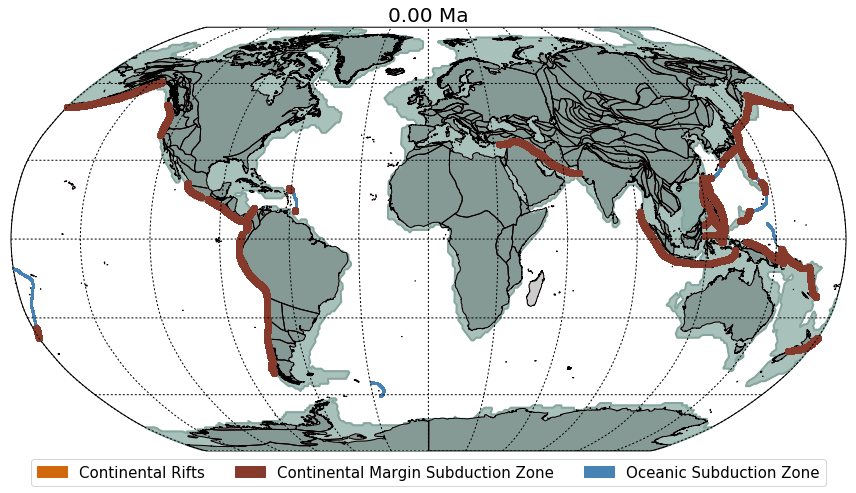

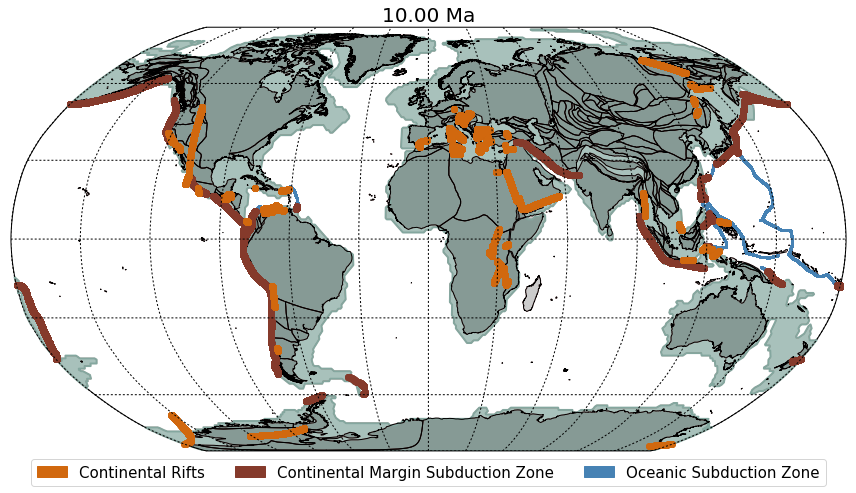

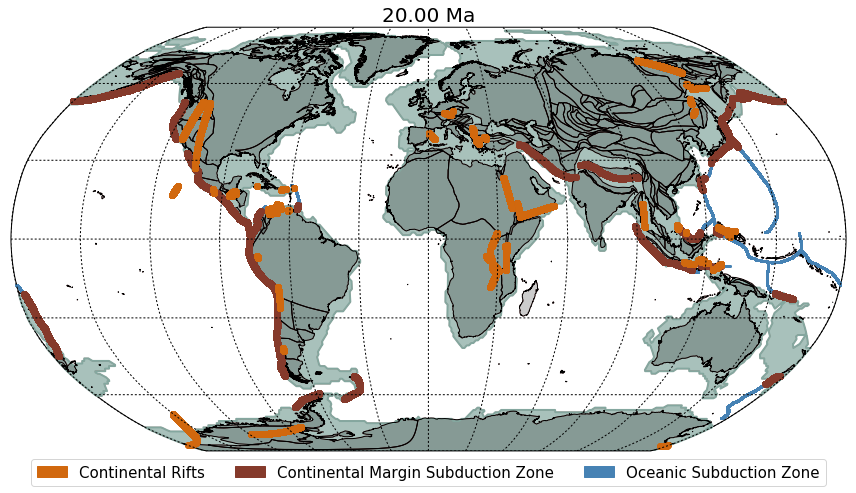

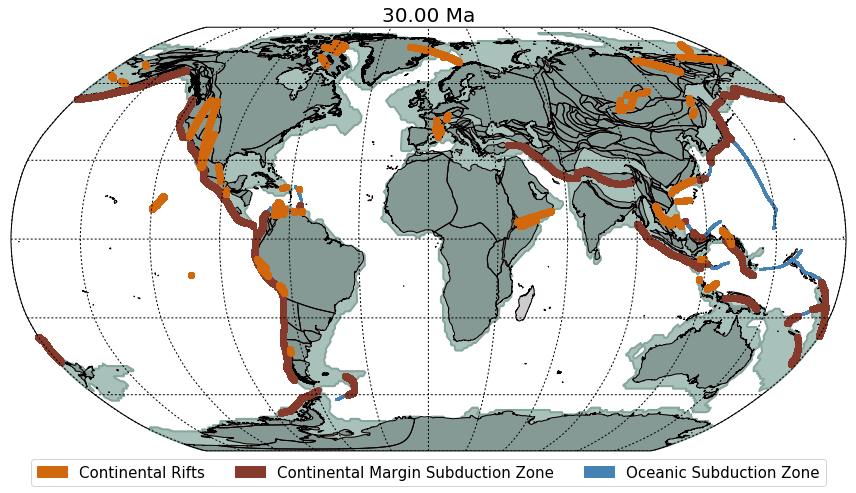

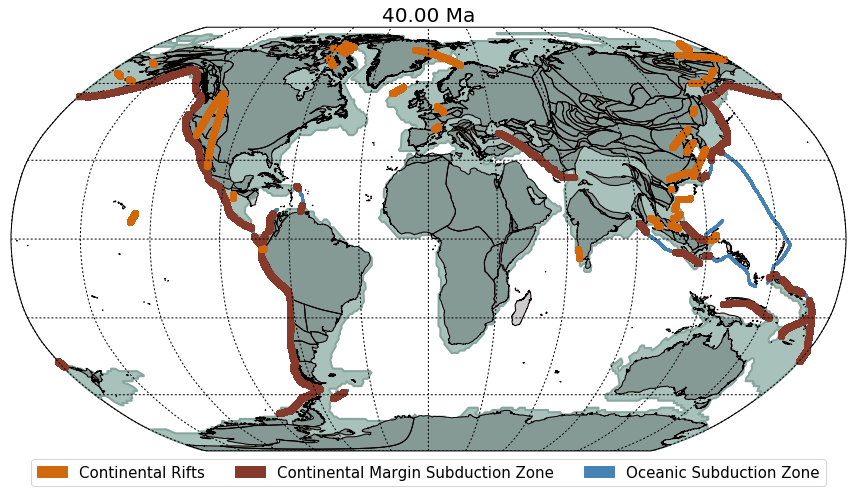

...

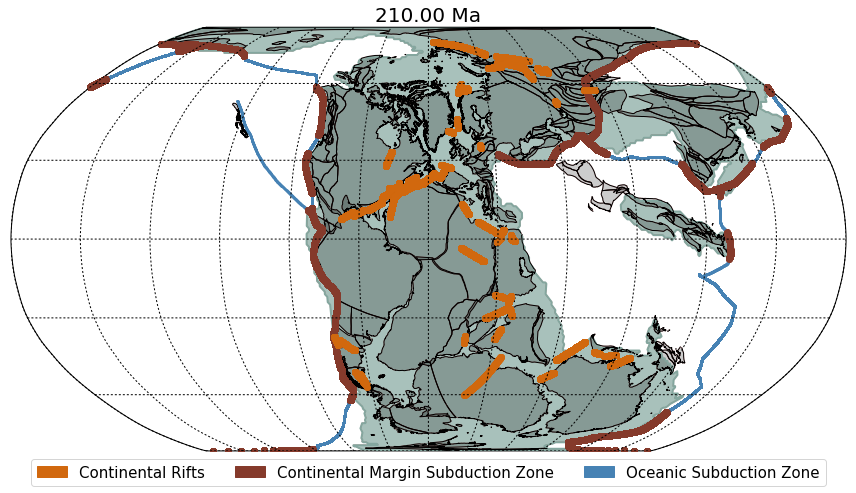

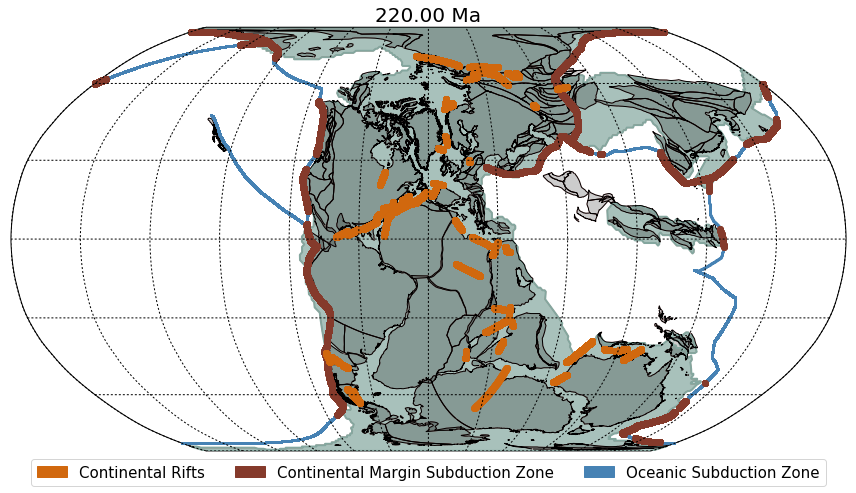

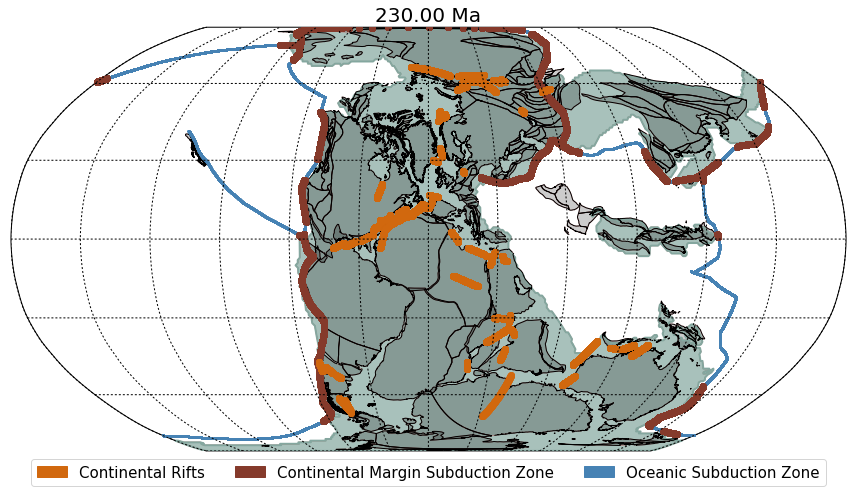

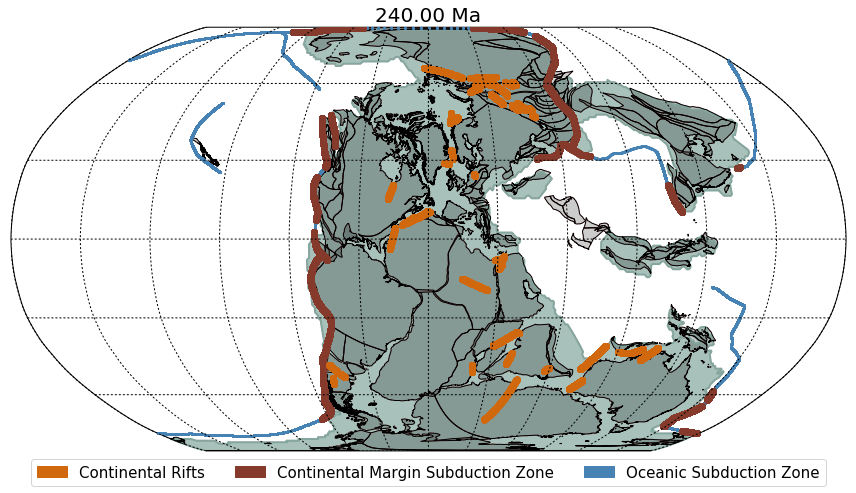

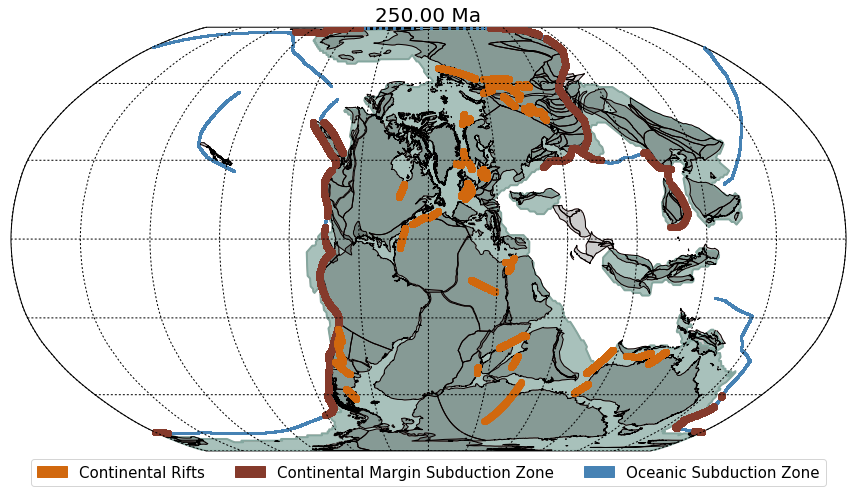

In [77]:
#extract data for 250-0
date_line_wrapper = pygplates.DateLineWrapper()

for i,time in enumerate(np.arange(0,260,10)):
    print time
    resolved_topologies = []
    shared_boundary_sections = []
    all_tesselated_shared_sub_segment = []
    continental_arcs = []
    reconstructed_COBs = []
    reconstructed_rifts = []
    reconstructed_cratons = []

    pygplates.resolve_topologies(topologies3, rotation_model_250_0, resolved_topologies, time, shared_boundary_sections)
    pygplates.reconstruct(cobter_410_0, rotation_model_250_0, reconstructed_COBs, time)
    pygplates.reconstruct(rifts_phanerozoic, rotation_model_250_0, reconstructed_rifts, time)
    pygplates.reconstruct(cratons_410_0, rotation_model_250_0, reconstructed_cratons, time)
      
    bi = run_grid_pip(time,points,cobter_410_0,rotation_model_250_0)
    
    contours = measure.find_contours(bi, .5)
    
    pad_hor = np.zeros((1,361))
    pad_ver = np.zeros((182,1))
    pad1 = np.vstack((bi,pad_hor))
    pad2 = np.hstack((pad_ver,pad1))
    pad3 = np.hstack((pad2,pad_ver))
    contours = measure.find_contours(pad3, 0.5, fully_connected='low')

    contour_polygons = []
    cobter_feature_collection = []
    for n,cp in enumerate(contours):
        cp[:,1] = cp[:,1]-1
        cp[:,0] = cp[:,0]-1

        cp[np.where(cp[:,0]<0.),0] = 0
        cp[np.where(cp[:,0]>180.),0] = 180
        cp[np.where(cp[:,1]<0.),1] = 0
        cp[np.where(cp[:,1]>360.),1] = 360
        cpf = pygplates.PolygonOnSphere(zip(cp[:,0]-90,cp[:,1]-180))
        contour_polygons.append(cpf)
        cobter_feature_collection.append(cpf)    
    fig = plt.figure(figsize=(12,8))
    m1 = Basemap(resolution='c',projection='robin',lon_0=0.)
    clip_path = m1.drawmapboundary()
    m1.drawmeridians(np.arange(0, 360, 30),labels=[0,0,0,0], fontsize=10)
    m1.drawparallels(np.arange(-90, 90, 30), labels=[0,0,0,0], fontsize=10)
    ax = plt.gca()

    area_threshold = 1250000
    area_threshold2 = 5000
    for pg in contour_polygons:
        if pg.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
            wrapped_polygons_lat = []
            wrapped_polygons_lon = []
            wrapped_polygons = date_line_wrapper.wrap(pg, 0.1)
            for wrapped_polygon in wrapped_polygons:
                for wrapped_point in wrapped_polygon.get_exterior_points():
                    wrapped_point_lat_lon = wrapped_point.get_latitude(), wrapped_point.get_longitude()
                    wrapped_polygons_lat.append(wrapped_point.get_latitude())
                    wrapped_polygons_lon.append(wrapped_point.get_longitude())
            
            x_geom, y_geom = m1(wrapped_polygons_lon, wrapped_polygons_lat)
            m1.plot(x_geom, y_geom, '#84a79f', linewidth=2, zorder=0)
            plt.fill(x_geom, y_geom, '#84a79f', edgecolor='r', fill=True, alpha=0.7, zorder=0)
 
    for crat in reconstructed_cratons:
        crat_geom = pygplates.PolygonOnSphere(crat.get_reconstructed_geometry())
        wrapped_cratons = date_line_wrapper.wrap(crat_geom, 1)
        for wrapped_craton in wrapped_cratons:
            wrapped_cratons_lat = []
            wrapped_cratons_lon = []
            for wrapped_craton_point in wrapped_craton.get_exterior_points():
                wrapped_craton_lat_lon = wrapped_craton_point.get_latitude(), wrapped_craton_point.get_longitude()
                wrapped_cratons_lat.append(wrapped_craton_point.get_latitude())
                wrapped_cratons_lon.append(wrapped_craton_point.get_longitude())

            x_geom_crat, y_geom_crat = m1(wrapped_cratons_lon, wrapped_cratons_lat)
            m1.plot(x_geom_crat, y_geom_crat, 'k', linewidth=1,zorder=0)
            plt.fill(x_geom_crat, y_geom_crat, 'k', edgecolor='r', fill=True, alpha=0.2,zorder=0)

    # Proximity Test
    sz_lons = []
    sz_lats = []
    trans_lons = []
    trans_lats = []
    sz_lons_non = []
    sz_lats_non = []
    distance_kms = 150
    distance_threshold_radians = distance_kms/pygplates.Earth.mean_radius_in_kms
    
    for shared_boundary_section in shared_boundary_sections:

        if shared_boundary_section.get_feature().get_feature_type() == pygplates.FeatureType.gpml_subduction_zone:

            for shared_sub_segment in shared_boundary_section.get_shared_sub_segments():
                tmp = shared_sub_segment.get_resolved_geometry()
                tesselated_shared_sub_segment = tmp.to_tessellated(np.radians(0.1))      

                all_tesselated_shared_sub_segment.append(tesselated_shared_sub_segment)
                count = 0
                for segment in tesselated_shared_sub_segment.get_segments():
                    
                    for pg2 in contour_polygons:

                        if pg2.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
                    
                            pg3 = pg2
                        
                            distance_radians = pygplates.GeometryOnSphere.distance(segment.get_arc_point(0.5), 
                                                                                   pg3,
                                                                                   distance_threshold_radians,
                                                                                   geometry2_is_solid=True)
                                                    
                            if distance_radians is not None:

                                sz_lons.append(segment.get_arc_point(0.5).to_lat_lon()[1])
                                sz_lats.append(segment.get_arc_point(0.5).to_lat_lon()[0])
                                #break
                                
                            if distance_radians is None:
                                sz_lons_non.append(segment.get_arc_point(0.5).to_lat_lon()[1])
                                sz_lats_non.append(segment.get_arc_point(0.5).to_lat_lon()[0])
                                #break

                            count += 1
               
                sz_lons_plot_non,sz_lats_plot_non = m1(sz_lons_non,sz_lats_non)
                m1.scatter(sz_lons_plot_non,sz_lats_plot_non, color='#4682b4', s=1)
                
                sz_lons_plot,sz_lats_plot = m1(sz_lons,sz_lats)
                m1.scatter(sz_lons_plot,sz_lats_plot, color='#853a2b') 
                
    rift_points = []
    rift_lats = []
    rift_lons = [] 
    for rift in reconstructed_rifts:
        if (rift.get_feature().get_valid_time()[0] > time) and (time > int(rift.get_feature().get_valid_time()[1]) ):
            rift_polyline = rift.get_reconstructed_geometry()
            tmp1 = rift_polyline.to_tessellated(np.radians(0.1))
            for rift_seg in tmp1.get_segments():
                rift_lons.append(rift_seg.get_arc_point(0.5).to_lat_lon()[1])
                rift_lats.append(rift_seg.get_arc_point(0.5).to_lat_lon()[0])
            x_rift,y_rift = m1(rift_lons,rift_lats)
            m1.scatter(x_rift,y_rift,color='#d1680e')#, linewidth=3)
            rift_points.append(tmp1.to_lat_lon_list())

    cont_rift = mpatches.Patch(color='#d1680e', label='Continental Rifts')
    cont_sz = mpatches.Patch(color='#853a2b', label='Continental Margin Subduction Zone')
    oceanic_sz = mpatches.Patch(color='#4682b4', label='Oceanic Subduction Zone')
            
    plt.title('%0.2f Ma' % (time), fontsize=20)
    plt.tight_layout()
    plt.legend(loc='lower center', ncol=3, bbox_to_anchor=(0.5,-0.1), handles=[cont_rift, cont_sz, oceanic_sz], fontsize=15)

       
    #Check for existing output directory and create it if not found
    if not os.path.exists('%s/output1/snapshots' % basedir_save):
        os.makedirs('%s/output1/snapshots' % basedir_save)

    #Check for existing output file with same name and remove if found
    if os.path.isfile('%soutput1/snapshots/%s' % (basedir_save, time)):
        os.remove('%soutput1/snapshots/%s' % (basedir_save, time))
        
    plt.savefig('%soutput1/snapshots/%s.png' % (basedir_save, time), bbox_inches='tight')

## Extract area of and number of continents from model

In [79]:
#extract data for 1000-410
date_line_wrapper = pygplates.DateLineWrapper()
plate_area_neop = [] 
plate_length_neop = []
plate_area_neop2 = [] 
plate_length_neop2 = []
for i,time in enumerate(np.arange(420,1010,10)):
    print time
    
    bi = run_grid_pip(time,points,cobter_1000_410,rotation_model_1000_410)
    
    contours = measure.find_contours(bi, .5)
    
    pad_hor = np.zeros((1,361))
    pad_ver = np.zeros((182,1))
    pad1 = np.vstack((bi,pad_hor))
    pad2 = np.hstack((pad_ver,pad1))
    pad3 = np.hstack((pad2,pad_ver))
    contours = measure.find_contours(pad3, 0.5, fully_connected='low')

    contour_polygons = []
    cobter_feature_collection = []
    for n,cp in enumerate(contours):
        cp[:,1] = cp[:,1]-1
        cp[:,0] = cp[:,0]-1

        cp[np.where(cp[:,0]<0.),0] = 0
        cp[np.where(cp[:,0]>180.),0] = 180
        cp[np.where(cp[:,1]<0.),1] = 0
        cp[np.where(cp[:,1]>360.),1] = 360
        cpf = pygplates.PolygonOnSphere(zip(cp[:,0]-90,cp[:,1]-180))
        contour_polygons.append(cpf)
        cobter_feature_collection.append(cpf)
        
    area_threshold = 1250000
    area_threshold2 = 10000

    tmp_neop_area = []
    tmp_neop_len = []
    tmp_neop_area2 = []
    tmp_neop_len2 = []
    for pg in contour_polygons:
        if pg.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
            tmp_neop_area.append(pg.get_area()*pygplates.Earth.mean_radius_in_kms**2)
            tmp_neop_len.append(pg.get_arc_length()*pygplates.Earth.mean_radius_in_kms)
        if pg.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold2:
            tmp_neop_area2.append(pg.get_area()*pygplates.Earth.mean_radius_in_kms**2)
            tmp_neop_len2.append(pg.get_arc_length()*pygplates.Earth.mean_radius_in_kms)

    plate_area_neop.append(tmp_neop_area)
    plate_length_neop.append(tmp_neop_len)
    plate_area_neop2.append(tmp_neop_area2)
    plate_length_neop2.append(tmp_neop_len2)

420
430
440
450
460
470
480
490
500
510
520
530
540
550
560
570
580
590
600
610
620
630
640
650
660
670
680
690
700
710
720
730
740
750
760
770
780
790
800
810
820
830
840
850
860
870
880
890
900
910
920
930
940
950
960
970
980
990
1000


In [80]:
#extract data for 1000-410
date_line_wrapper = pygplates.DateLineWrapper()
plate_area_palaeo = [] 
plate_length_palaeo = []
plate_area_palaeo2 = [] 
plate_length_palaeo2 = []
for i,time in enumerate(np.arange(260,420,10)):
    print time
    
    bi = run_grid_pip(time,points,cobter_410_0,rotation_model_410_250)
    
    contours = measure.find_contours(bi, .5)
    
    pad_hor = np.zeros((1,361))
    pad_ver = np.zeros((182,1))
    pad1 = np.vstack((bi,pad_hor))
    pad2 = np.hstack((pad_ver,pad1))
    pad3 = np.hstack((pad2,pad_ver))
    contours = measure.find_contours(pad3, 0.5, fully_connected='low')

    contour_polygons = []
    cobter_feature_collection = []
    for n,cp in enumerate(contours):
        cp[:,1] = cp[:,1]-1
        cp[:,0] = cp[:,0]-1

        cp[np.where(cp[:,0]<0.),0] = 0
        cp[np.where(cp[:,0]>180.),0] = 180
        cp[np.where(cp[:,1]<0.),1] = 0
        cp[np.where(cp[:,1]>360.),1] = 360
        cpf = pygplates.PolygonOnSphere(zip(cp[:,0]-90,cp[:,1]-180))
        contour_polygons.append(cpf)
        cobter_feature_collection.append(cpf)
        
    area_threshold = 1250000
    area_threshold2 = 10000

    tmp_palaeo_area = []
    tmp_palaeo_len = []
    tmp_palaeo_area2 = []
    tmp_palaeo_len2 = []
    for pg in contour_polygons:
        if pg.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
            tmp_palaeo_area.append(pg.get_area()*pygplates.Earth.mean_radius_in_kms**2)
            tmp_palaeo_len.append(pg.get_arc_length()*pygplates.Earth.mean_radius_in_kms)
        if pg.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold2:
            tmp_palaeo_area2.append(pg.get_area()*pygplates.Earth.mean_radius_in_kms**2)
            tmp_palaeo_len2.append(pg.get_arc_length()*pygplates.Earth.mean_radius_in_kms)

    plate_area_palaeo.append(tmp_palaeo_area)
    plate_length_palaeo.append(tmp_palaeo_len)
    plate_area_palaeo2.append(tmp_palaeo_area2)
    plate_length_palaeo2.append(tmp_palaeo_len2)

260
270
280
290
300
310
320
330
340
350
360
370
380
390
400
410


In [81]:
#extract data for 1000-410
date_line_wrapper = pygplates.DateLineWrapper()
plate_area_mesoceno = [] 
plate_length_mesoceno = []

plate_area_mesoceno2 = [] 
plate_length_mesoceno2 = []

for i,time in enumerate(np.arange(0,260,10)):
    print time
      
    bi = run_grid_pip(time,points,cobter_410_0,rotation_model_250_0)
    
    contours = measure.find_contours(bi, .5)
    
    pad_hor = np.zeros((1,361))
    pad_ver = np.zeros((182,1))
    pad1 = np.vstack((bi,pad_hor))
    pad2 = np.hstack((pad_ver,pad1))
    pad3 = np.hstack((pad2,pad_ver))
    contours = measure.find_contours(pad3, 0.5, fully_connected='low')

    contour_polygons = []
    cobter_feature_collection = []
    for n,cp in enumerate(contours):
        cp[:,1] = cp[:,1]-1
        cp[:,0] = cp[:,0]-1

        cp[np.where(cp[:,0]<0.),0] = 0
        cp[np.where(cp[:,0]>180.),0] = 180
        cp[np.where(cp[:,1]<0.),1] = 0
        cp[np.where(cp[:,1]>360.),1] = 360
        cpf = pygplates.PolygonOnSphere(zip(cp[:,0]-90,cp[:,1]-180))
        contour_polygons.append(cpf)
        cobter_feature_collection.append(cpf)
        
    area_threshold = 1250000
    area_threshold2 = 10000

    tmp_mesoceno_area = []
    tmp_mesoceno_len = []
    tmp_mesoceno_area2 = []
    tmp_mesoceno_len2 = []
    for pg in contour_polygons:
        if pg.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
            tmp_mesoceno_area.append(pg.get_area()*pygplates.Earth.mean_radius_in_kms**2)
            tmp_mesoceno_len.append(pg.get_arc_length()*pygplates.Earth.mean_radius_in_kms)
        if pg.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold2:
            tmp_mesoceno_area2.append(pg.get_area()*pygplates.Earth.mean_radius_in_kms**2)
            tmp_mesoceno_len2.append(pg.get_arc_length()*pygplates.Earth.mean_radius_in_kms)

    plate_area_mesoceno.append(tmp_mesoceno_area)
    plate_length_mesoceno.append(tmp_mesoceno_len)
    plate_area_mesoceno2.append(tmp_mesoceno_area2)
    plate_length_mesoceno2.append(tmp_mesoceno_len2)

0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170
180
190
200
210
220
230
240
250


In [82]:
timerange = np.arange(0,1010,10)

In [83]:
len(timerange)

101

In [84]:
plate_area = plate_area_mesoceno + plate_area_palaeo + plate_area_neop
plate_length = plate_length_mesoceno + plate_length_palaeo + plate_length_neop
plate_area2 = plate_area_mesoceno2 + plate_area_palaeo2 + plate_area_neop2
plate_length2 = plate_length_mesoceno2 + plate_length_palaeo2 + plate_length_neop2

In [85]:
summed_timesteps_area = []
for n,i in enumerate(plate_area):
    summed_timesteps_area.append(sum(i))
    
summed_timesteps_length = []
for n,j in enumerate(plate_length):
    summed_timesteps_length.append(sum(j))
    
summed_timesteps_area2 = []
for n,i in enumerate(plate_area2):
    summed_timesteps_area2.append(sum(i))
    
summed_timesteps_length2 = []
for n,j in enumerate(plate_length2):
    summed_timesteps_length2.append(sum(j))

In [86]:
ratio = []
for a,l in zip(summed_timesteps_area, summed_timesteps_length):
    ratio.append(l/a)
    
ratio2 = []
for a2,l2 in zip(summed_timesteps_area2, summed_timesteps_length2):
    ratio2.append(l2/a2)

In [95]:
total_area = []
total_area2 = []
for a in summed_timesteps_area:
    total_area.append(a)
    
ratio2 = []
for a2 in summed_timesteps_area2:
    total_area2.append(a2)

In [87]:
#to normalise?
norm = [float(i)/max(ratio) for i in ratio]
norm2 = [float(j)/max(ratio2) for j in ratio2]

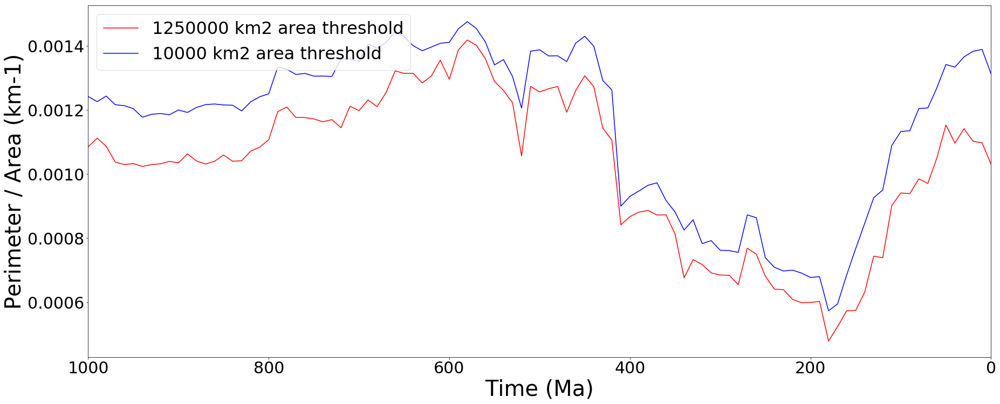

In [88]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(30,12),facecolor='w', edgecolor='k')
ax.plot(timerange,ratio, 'r', label='1250000 km2 area threshold')
ax.plot(timerange,ratio2, 'b', label='10000 km2 area threshold')
ax.set_xlim(1000,0)
#ax.set_ylim(0, 14)
ax.tick_params(axis='x', labelsize=30)
ax.tick_params(axis='y', labelsize=30)
ax.set_xlabel('Time (Ma)', fontsize=40)
ax.set_ylabel('Area (km2)', fontsize=40)
ax.set_ylabel('Perimeter / Area (km-1)', fontsize=40)
ax.legend(loc='upper left',fontsize=32,bbox_to_anchor=(0,1))
#plt.savefig("Peri:Area.pdf")

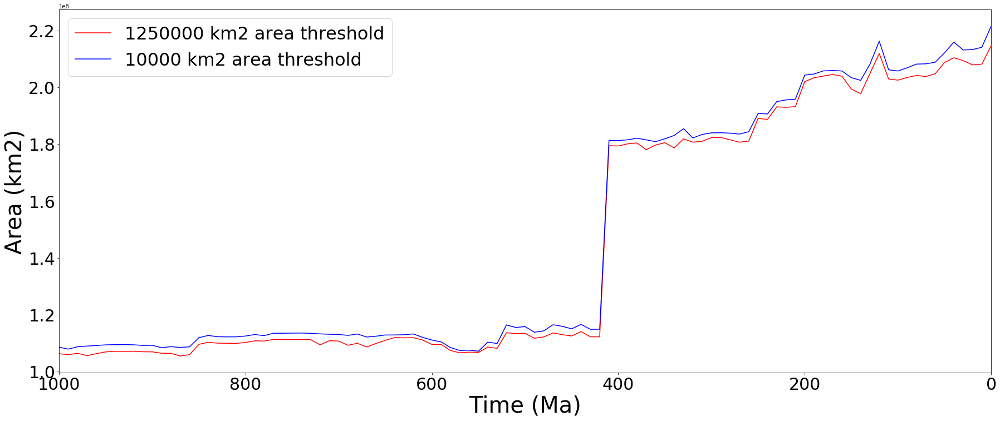

In [98]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(30,12),facecolor='w', edgecolor='k')
ax.plot(timerange,total_area, 'r', label='1250000 km2 area threshold')
ax.plot(timerange,total_area2, 'b', label='10000 km2 area threshold')
ax.set_xlim(1000,0)
#ax.set_ylim(0, 14)
ax.tick_params(axis='x', labelsize=30)
ax.tick_params(axis='y', labelsize=30)
ax.set_xlabel('Time (Ma)', fontsize=40)
ax.set_ylabel('Area (km2)', fontsize=40)
ax.legend(loc='upper left',fontsize=32,bbox_to_anchor=(0,1))
#plt.savefig("Peri:Area.pdf")

In [89]:
ratio_max = []
for i,j in enumerate(ratio):
    ratio_max.append(max(j))
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(30,12),facecolor='w', edgecolor='k')
ax.plot(timerange,ratio_max, 'r', label='area of largest continent')

TypeError: 'float' object is not iterable

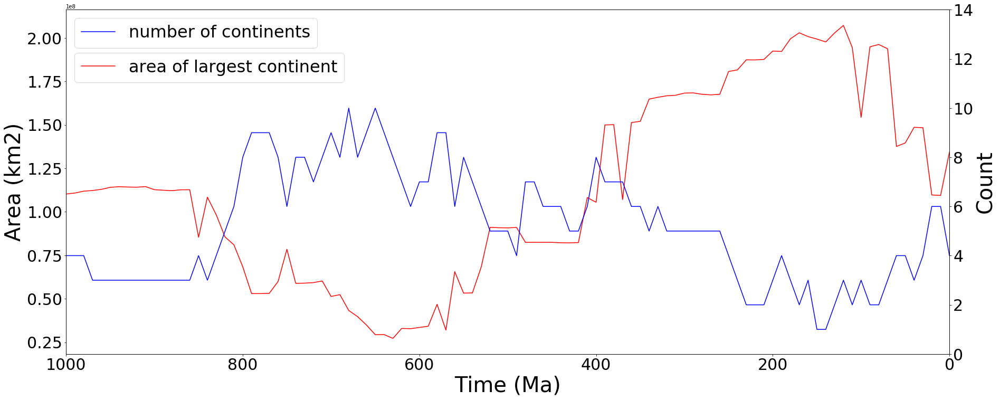

In [201]:
max_area = []
no_conts = []
for i,j in enumerate(plate_area):
    max_area.append(max(j))
    no_conts.append(len(j))
fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(30,12),facecolor='w', edgecolor='k')
ax2 = ax1.twinx()
ax1.plot(timerange,max_area, 'r', label='area of largest continent')
ax2.plot(timerange,no_conts, 'b', label='number of continents')
ax1.set_xlim(1000,0)
ax2.set_ylim(0, 14)
ax1.tick_params(axis='x', labelsize=30)
ax1.tick_params(axis='y', labelsize=30)
ax2.tick_params(axis='y', labelsize=30)
ax1.set_xlabel('Time (Ma)', fontsize=40)
ax1.set_ylabel('Area (km2)', fontsize=40)
ax2.set_ylabel('Count', fontsize=40)
ax1.legend(loc='upper left',fontsize=32,bbox_to_anchor=(0,.9))
ax2.legend(loc='upper left',fontsize=32,bbox_to_anchor=(0,1))
plt.savefig("Bradley_2011_metrics.pdf")

### The following cells are for generating AI compatible files at specific time steps.  The method of plotting arcs is changed from dots to lines to make smaller file sizes

250


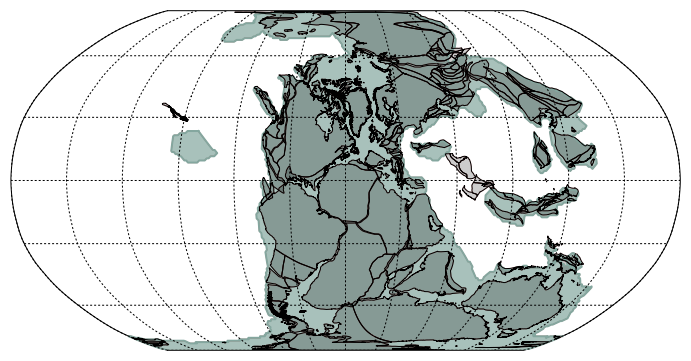

In [22]:
#extract data for 1000-410
date_line_wrapper = pygplates.DateLineWrapper(0)

for i,time in enumerate(np.arange(250,260,10)):
    print time
    resolved_topologies = []
    shared_boundary_sections = []
    all_tesselated_shared_sub_segment = []
    continental_arcs = []
    reconstructed_COBs = []
    reconstructed_rifts = []
    reconstructed_cratons = []

    pygplates.resolve_topologies(topologies2, rotation_model_410_250, resolved_topologies, time, shared_boundary_sections)
    pygplates.reconstruct(cobter_410_0, rotation_model_410_250, reconstructed_COBs, time)
    pygplates.reconstruct(rifts, rotation_model_410_250, reconstructed_rifts, time)
    pygplates.reconstruct(cratons_410_0, rotation_model_410_250, reconstructed_cratons, time)
      
    bi = run_grid_pip(time,points,cobter_410_0,rotation_model_410_250)
    
    contours = measure.find_contours(bi, .5)
    
    pad_hor = np.zeros((1,361))
    pad_ver = np.zeros((182,1))
    pad1 = np.vstack((bi,pad_hor))
    pad2 = np.hstack((pad_ver,pad1))
    pad3 = np.hstack((pad2,pad_ver))
    contours = measure.find_contours(pad3, 0.5, fully_connected='low')

    contour_polygons = []
    cobter_feature_collection = []
    for n,cp in enumerate(contours):
        cp[:,1] = cp[:,1]-1
        cp[:,0] = cp[:,0]-1

        cp[np.where(cp[:,0]<0.),0] = 0
        cp[np.where(cp[:,0]>180.),0] = 180
        cp[np.where(cp[:,1]<0.),1] = 0
        cp[np.where(cp[:,1]>360.),1] = 360
        cpf = pygplates.PolygonOnSphere(zip(cp[:,0]-90,cp[:,1]-180))
        contour_polygons.append(cpf)
        cobter_feature_collection.append(cpf)
        
    
    fig = plt.figure(figsize=(12,8))
    m1 = Basemap(resolution='c',projection='robin',lon_0=0.)
    clip_path = m1.drawmapboundary()
    m1.drawmeridians(np.arange(0, 360, 30),labels=[0,0,0,0], fontsize=10)
    m1.drawparallels(np.arange(-90, 90, 30), labels=[0,0,0,0], fontsize=10)
    ax = plt.gca()

    area_threshold = 1250000

    for pg in contour_polygons:
        if pg.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
            wrapped_polygons_lat = []
            wrapped_polygons_lon = []
            wrapped_polygons = date_line_wrapper.wrap(pg, 1)
            for wrapped_polygon in wrapped_polygons:
                for wrapped_point in wrapped_polygon.get_exterior_points():
                    wrapped_point_lat_lon = wrapped_point.get_latitude(), wrapped_point.get_longitude()
                    wrapped_polygons_lat.append(wrapped_point.get_latitude())
                    wrapped_polygons_lon.append(wrapped_point.get_longitude())
                     
            x_geom, y_geom = m1(wrapped_polygons_lon, wrapped_polygons_lat)
            m1.plot(x_geom, y_geom, '#84a79f', linewidth=2, zorder=0)
            plt.fill(x_geom, y_geom, '#84a79f', edgecolor='r', fill=True, alpha=0.7, zorder=0)
            
    for crat in reconstructed_cratons:
        crat_geom = pygplates.PolygonOnSphere(crat.get_reconstructed_geometry())
        wrapped_cratons = date_line_wrapper.wrap(crat_geom, 1)
        for wrapped_craton in wrapped_cratons:
            wrapped_cratons_lat = []
            wrapped_cratons_lon = []
            for wrapped_craton_point in wrapped_craton.get_exterior_points():
                wrapped_craton_lat_lon = wrapped_craton_point.get_latitude(), wrapped_craton_point.get_longitude()
                wrapped_cratons_lat.append(wrapped_craton_point.get_latitude())
                wrapped_cratons_lon.append(wrapped_craton_point.get_longitude())

            x_geom_crat, y_geom_crat = m1(wrapped_cratons_lon, wrapped_cratons_lat)
            m1.plot(x_geom_crat, y_geom_crat, 'k', linewidth=1,zorder=0)
            plt.fill(x_geom_crat, y_geom_crat, 'k', edgecolor='r', fill=True, alpha=0.2,zorder=0)

    
    # Proximity Test


    trans_lons = []
    trans_lats = []
    distance_kms = 100
    distance_threshold_radians = distance_kms/pygplates.Earth.mean_radius_in_kms
    
    for shared_boundary_section in shared_boundary_sections:

        if shared_boundary_section.get_feature().get_feature_type() == pygplates.FeatureType.gpml_subduction_zone:

            for shared_sub_segment in shared_boundary_section.get_shared_sub_segments():
                tmp = shared_sub_segment.get_resolved_geometry()
                tesselated_shared_sub_segment = tmp.to_tessellated(np.radians(0.5))      

                all_tesselated_shared_sub_segment.append(tesselated_shared_sub_segment)
                count = 0
                sz_lons = []
                sz_lats = []
                sz_lons_non = []
                sz_lats_non = []
                for segment in tesselated_shared_sub_segment.get_segments():

                    for pg2 in contour_polygons:

                        if pg2.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
                    
                            pg3 = pg2
                        
                            distance_radians = pygplates.GeometryOnSphere.distance(segment.get_arc_point(0.5), 
                                                                                   pg3,
                                                                                   distance_threshold_radians,
                                                                                   geometry2_is_solid=True)
                           
                            if distance_radians is not None:

                                sz_lons.append(segment.get_arc_point(0.5).to_lat_lon()[1])
                                sz_lats.append(segment.get_arc_point(0.5).to_lat_lon()[0])
                                #break
                                
                            if distance_radians is None:
                                sz_lons_non.append(segment.get_arc_point(0.5).to_lat_lon()[1])
                                sz_lats_non.append(segment.get_arc_point(0.5).to_lat_lon()[0])
                                #break
#
                            #count += 1
                            
               
                #sz_lons_plot_non,sz_lats_plot_non = m1(sz_lons_non,sz_lats_non)
                #m1.scatter(sz_lons_plot_non,sz_lats_plot_non, color='#4682b4', s=1)
                    i = zip(sz_lats, sz_lons)
                    #print i
                    if len(i) > 2:
                        polyline = pygplates.PolylineOnSphere(i)
                        wrapped_polylines = date_line_wrapper.wrap(polyline)
                        for wrapped_polyline in wrapped_polylines:
                            wrapped_point_lat = []
                            wrapped_point_lon = []
                            for wrapped_point in wrapped_polyline.get_points():
                                wrapped_point_lat.append(wrapped_point.get_latitude())
                                wrapped_point_lon.append(wrapped_point.get_longitude())
                                sz_lons_plot,sz_lats_plot = m1(wrapped_point_lon,wrapped_point_lat)
                                m1.plot(sz_lons_plot,sz_lats_plot, color='#853a2b', linewidth=5, zorder=2)  

                    j = zip(sz_lats_non, sz_lons_non)
                    if len(j) > 2:
                        polyline1 = pygplates.PolylineOnSphere(j)
                        wrapped_polylines1 = date_line_wrapper.wrap(polyline1)
                        for wrapped_polyline1 in wrapped_polylines1:
                            wrapped_point_lat1 = []
                            wrapped_point_lon1 = []
                            for wrapped_point1 in wrapped_polyline1.get_points():
                                wrapped_point_lat1.append(wrapped_point1.get_latitude())
                                wrapped_point_lon1.append(wrapped_point1.get_longitude())
                            sz_lons_plot_non,sz_lats_plot_non = m1(wrapped_point_lon1,wrapped_point_lat1)
                            m1.plot(sz_lons_plot_non,sz_lats_plot_non, color='#4682b4', linewidth=3, zorder=1)            


                
    rift_points = []
    rift_lats = []
    rift_lons = [] 
    for rift in reconstructed_rifts:
        #tmp_valid_time = np.arange(int(rift.get_valid_time()[1]), int(rift.get_valid_time()[0]), 1)
        #print rift.get_valid_time()[0] > time
        #print int(rift.get_description()) < time
        if (rift.get_feature().get_valid_time()[0] > time) and (time > int(rift.get_feature().get_valid_time()[1]) ):
            rift_polyline = rift.get_reconstructed_geometry()
            tmp1 = rift_polyline.to_tessellated(np.radians(0.1))
            for rift_seg in tmp1.get_segments():
                #print rift_seg
                rift_lons.append(rift_seg.get_arc_point(0.5).to_lat_lon()[1])
                rift_lats.append(rift_seg.get_arc_point(0.5).to_lat_lon()[0])
            x_rift,y_rift = m1(rift_lons,rift_lats)
            m1.scatter(x_rift,y_rift,color='#d1680e')#, linewidth=3)
            rift_points.append(tmp1.to_lat_lon_list())
           

    plt.savefig('%soutput1/%s.png' % basedir_save, time, format='eps', bbox_inches='tight')

450


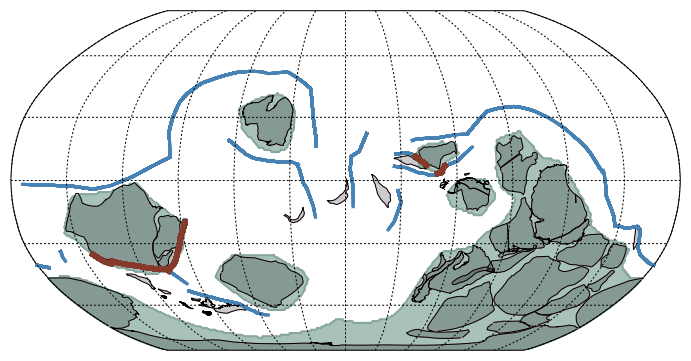

In [24]:
#extract data for 1000-410
date_line_wrapper = pygplates.DateLineWrapper(0)

for i,time in enumerate(np.arange(450,460,10)):
    print time
    resolved_topologies = []
    shared_boundary_sections = []
    all_tesselated_shared_sub_segment = []
    all_tesselated_shared_sub_segment2 = []
    continental_arcs = []
    reconstructed_COBs = []
    reconstructed_rifts = []
    reconstructed_cratons = []
    
    pygplates.resolve_topologies(topologies, rotation_model_1000_410, resolved_topologies, time, shared_boundary_sections)
    pygplates.reconstruct(cobter_1000_410, rotation_model_1000_410, reconstructed_COBs, time)
    pygplates.reconstruct(rifts, rotation_model_1000_410, reconstructed_rifts, time)
    pygplates.reconstruct(cratons_1000_410, rotation_model_1000_410, reconstructed_cratons, time)
    
    bi = run_grid_pip(time,points,cobter_1000_410,rotation_model_1000_410)
    
    contours = measure.find_contours(bi, .5)
    
    pad_hor = np.zeros((1,361))
    pad_ver = np.zeros((182,1))
    pad1 = np.vstack((bi,pad_hor))
    pad2 = np.hstack((pad_ver,pad1))
    pad3 = np.hstack((pad2,pad_ver))
    contours = measure.find_contours(pad3, 0.5, fully_connected='low')

    contour_polygons = []
    cobter_feature_collection = []
    for n,cp in enumerate(contours):
        cp[:,1] = cp[:,1]-1
        cp[:,0] = cp[:,0]-1

        cp[np.where(cp[:,0]<0.),0] = 0
        cp[np.where(cp[:,0]>180.),0] = 180
        cp[np.where(cp[:,1]<0.),1] = 0
        cp[np.where(cp[:,1]>360.),1] = 360
        cpf = pygplates.PolygonOnSphere(zip(cp[:,0]-90,cp[:,1]-180))
        contour_polygons.append(cpf)
        cobter_feature_collection.append(cpf)
        
    
    fig = plt.figure(figsize=(12,8))
    m1 = Basemap(resolution='c',projection='robin',lon_0=0.)
    clip_path = m1.drawmapboundary()
    m1.drawmeridians(np.arange(0, 360, 30),labels=[0,0,0,0], fontsize=10)
    m1.drawparallels(np.arange(-90, 90, 30), labels=[0,0,0,0], fontsize=10)
    ax = plt.gca()

    area_threshold = 1250000

    for pg in contour_polygons:
        if pg.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
            wrapped_polygons_lat = []
            wrapped_polygons_lon = []
            wrapped_polygons = date_line_wrapper.wrap(pg, 1)
            for wrapped_polygon in wrapped_polygons:
                for wrapped_point in wrapped_polygon.get_exterior_points():
                    wrapped_point_lat_lon = wrapped_point.get_latitude(), wrapped_point.get_longitude()
                    wrapped_polygons_lat.append(wrapped_point.get_latitude())
                    wrapped_polygons_lon.append(wrapped_point.get_longitude())
                     
            x_geom, y_geom = m1(wrapped_polygons_lon, wrapped_polygons_lat)
            m1.plot(x_geom, y_geom, '#84a79f', linewidth=2, zorder=0)
            plt.fill(x_geom, y_geom, '#84a79f', edgecolor='r', fill=True, alpha=0.7, zorder=0)
            
    for crat in reconstructed_cratons:
        crat_geom = pygplates.PolygonOnSphere(crat.get_reconstructed_geometry())
        wrapped_cratons = date_line_wrapper.wrap(crat_geom, 1)
        for wrapped_craton in wrapped_cratons:
            wrapped_cratons_lat = []
            wrapped_cratons_lon = []
            for wrapped_craton_point in wrapped_craton.get_exterior_points():
                wrapped_craton_lat_lon = wrapped_craton_point.get_latitude(), wrapped_craton_point.get_longitude()
                wrapped_cratons_lat.append(wrapped_craton_point.get_latitude())
                wrapped_cratons_lon.append(wrapped_craton_point.get_longitude())

            x_geom_crat, y_geom_crat = m1(wrapped_cratons_lon, wrapped_cratons_lat)
            m1.plot(x_geom_crat, y_geom_crat, 'k', linewidth=1,zorder=0)
            plt.fill(x_geom_crat, y_geom_crat, 'k', edgecolor='r', fill=True, alpha=0.2,zorder=0)

    
    # Proximity Test


    trans_lons = []
    trans_lats = []
    distance_kms = 100
    distance_threshold_radians = distance_kms/pygplates.Earth.mean_radius_in_kms
    
    for shared_boundary_section in shared_boundary_sections:

        if shared_boundary_section.get_feature().get_feature_type() == pygplates.FeatureType.gpml_subduction_zone:

            for shared_sub_segment in shared_boundary_section.get_shared_sub_segments():
                tmp = shared_sub_segment.get_resolved_geometry()
                tesselated_shared_sub_segment = tmp.to_tessellated(np.radians(0.5))      

                all_tesselated_shared_sub_segment.append(tesselated_shared_sub_segment)
                count = 0
                sz_lons = []
                sz_lats = []
                sz_lons_non = []
                sz_lats_non = []
                for segment in tesselated_shared_sub_segment.get_segments():

                    for pg2 in contour_polygons:

                        if pg2.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
                    
                            pg3 = pg2
                        
                            distance_radians = pygplates.GeometryOnSphere.distance(segment.get_arc_point(0.5), 
                                                                                   pg3,
                                                                                   distance_threshold_radians,
                                                                                   geometry2_is_solid=True)
                           
                            if distance_radians is not None:

                                sz_lons.append(segment.get_arc_point(0.5).to_lat_lon()[1])
                                sz_lats.append(segment.get_arc_point(0.5).to_lat_lon()[0])
                                #break
                                
                            if distance_radians is None:
                                sz_lons_non.append(segment.get_arc_point(0.5).to_lat_lon()[1])
                                sz_lats_non.append(segment.get_arc_point(0.5).to_lat_lon()[0])
                                #break
#
                            #count += 1
                            
               
                #sz_lons_plot_non,sz_lats_plot_non = m1(sz_lons_non,sz_lats_non)
                #m1.scatter(sz_lons_plot_non,sz_lats_plot_non, color='#4682b4', s=1)
                    i = zip(sz_lats, sz_lons)
                    #print i
                    if len(i) > 2:
                        polyline = pygplates.PolylineOnSphere(i)
                        wrapped_polylines = date_line_wrapper.wrap(polyline)
                        for wrapped_polyline in wrapped_polylines:
                            wrapped_point_lat = []
                            wrapped_point_lon = []
                            for wrapped_point in wrapped_polyline.get_points():
                                wrapped_point_lat.append(wrapped_point.get_latitude())
                                wrapped_point_lon.append(wrapped_point.get_longitude())
                                sz_lons_plot,sz_lats_plot = m1(wrapped_point_lon,wrapped_point_lat)
                                m1.plot(sz_lons_plot,sz_lats_plot, color='#853a2b', linewidth=5, zorder=2)  

                    j = zip(sz_lats_non, sz_lons_non)
                    if len(j) > 2:
                        polyline1 = pygplates.PolylineOnSphere(j)
                        wrapped_polylines1 = date_line_wrapper.wrap(polyline1)
                        for wrapped_polyline1 in wrapped_polylines1:
                            wrapped_point_lat1 = []
                            wrapped_point_lon1 = []
                            for wrapped_point1 in wrapped_polyline1.get_points():
                                wrapped_point_lat1.append(wrapped_point1.get_latitude())
                                wrapped_point_lon1.append(wrapped_point1.get_longitude())
                            sz_lons_plot_non,sz_lats_plot_non = m1(wrapped_point_lon1,wrapped_point_lat1)
                            m1.plot(sz_lons_plot_non,sz_lats_plot_non, color='#4682b4', linewidth=3, zorder=1)            

                
    rift_points = []
    rift_lats = []
    rift_lons = [] 
    for rift in reconstructed_rifts:
        #tmp_valid_time = np.arange(int(rift.get_valid_time()[1]), int(rift.get_valid_time()[0]), 1)
        #print rift.get_valid_time()[0] > time
        #print int(rift.get_description()) < time
        if (rift.get_feature().get_valid_time()[0] > time) and (time > int(rift.get_feature().get_valid_time()[1]) ):
            rift_polyline = rift.get_reconstructed_geometry()
            tmp1 = rift_polyline.to_tessellated(np.radians(0.1))
            for rift_seg in tmp1.get_segments():
                #print rift_seg
                rift_lons.append(rift_seg.get_arc_point(0.5).to_lat_lon()[1])
                rift_lats.append(rift_seg.get_arc_point(0.5).to_lat_lon()[0])
            x_rift,y_rift = m1(rift_lons,rift_lats)
            m1.scatter(x_rift,y_rift,color='#d1680e')#, linewidth=3)
            rift_points.append(tmp1.to_lat_lon_list())
           
             
    #plt.title('Age = %0.2f Ma' % (time), fontsize=20)
    #plt.tight_layout()
    #   
    ## Check for existing output directory and create it if not found
    #if not os.path.exists("output"):
    #    os.makedirs("output")
#
    ## Check for existing output file with same name and remove if found
    #if os.path.isfile("output/" + str('%s') % time):
    #    os.remove("output/" + str('%s') % time)

    plt.savefig('%soutput1/%s.png' % basedir_save, time, format='eps', bbox_inches='tight')

250


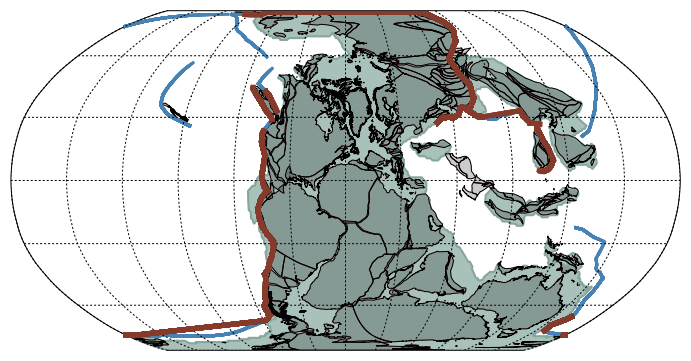

In [23]:
#extract data for 1000-410
date_line_wrapper = pygplates.DateLineWrapper(0)

for i,time in enumerate(np.arange(250,260,10)):
    print time
    resolved_topologies = []
    shared_boundary_sections = []
    all_tesselated_shared_sub_segment = []
    continental_arcs = []
    reconstructed_COBs = []
    reconstructed_rifts = []
    reconstructed_cratons = []

    pygplates.resolve_topologies(topologies3, rotation_model_250_0, resolved_topologies, time, shared_boundary_sections)
    pygplates.reconstruct(cobter_410_0, rotation_model_250_0, reconstructed_COBs, time)
    pygplates.reconstruct(rifts, rotation_model_250_0, reconstructed_rifts, time)
    pygplates.reconstruct(cratons_410_0, rotation_model_250_0, reconstructed_cratons, time)
      
    bi = run_grid_pip(time,points,cobter_410_0,rotation_model_250_0)
    
    contours = measure.find_contours(bi, .5)
    
    pad_hor = np.zeros((1,361))
    pad_ver = np.zeros((182,1))
    pad1 = np.vstack((bi,pad_hor))
    pad2 = np.hstack((pad_ver,pad1))
    pad3 = np.hstack((pad2,pad_ver))
    contours = measure.find_contours(pad3, 0.5, fully_connected='low')

    contour_polygons = []
    cobter_feature_collection = []
    for n,cp in enumerate(contours):
        cp[:,1] = cp[:,1]-1
        cp[:,0] = cp[:,0]-1

        cp[np.where(cp[:,0]<0.),0] = 0
        cp[np.where(cp[:,0]>180.),0] = 180
        cp[np.where(cp[:,1]<0.),1] = 0
        cp[np.where(cp[:,1]>360.),1] = 360
        cpf = pygplates.PolygonOnSphere(zip(cp[:,0]-90,cp[:,1]-180))
        contour_polygons.append(cpf)
        cobter_feature_collection.append(cpf)
        
    
    fig = plt.figure(figsize=(12,8))
    m1 = Basemap(resolution='c',projection='robin',lon_0=0.)
    clip_path = m1.drawmapboundary()
    m1.drawmeridians(np.arange(0, 360, 30),labels=[0,0,0,0], fontsize=10)
    m1.drawparallels(np.arange(-90, 90, 30), labels=[0,0,0,0], fontsize=10)
    ax = plt.gca()

    area_threshold = 1250000

    for pg in contour_polygons:
        if pg.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
            wrapped_polygons_lat = []
            wrapped_polygons_lon = []
            wrapped_polygons = date_line_wrapper.wrap(pg, 1)
            for wrapped_polygon in wrapped_polygons:
                for wrapped_point in wrapped_polygon.get_exterior_points():
                    wrapped_point_lat_lon = wrapped_point.get_latitude(), wrapped_point.get_longitude()
                    wrapped_polygons_lat.append(wrapped_point.get_latitude())
                    wrapped_polygons_lon.append(wrapped_point.get_longitude())
                     
            x_geom, y_geom = m1(wrapped_polygons_lon, wrapped_polygons_lat)
            m1.plot(x_geom, y_geom, '#84a79f', linewidth=2, zorder=0)
            plt.fill(x_geom, y_geom, '#84a79f', edgecolor='r', fill=True, alpha=0.7, zorder=0)
            
    for crat in reconstructed_cratons:
        crat_geom = pygplates.PolygonOnSphere(crat.get_reconstructed_geometry())
        wrapped_cratons = date_line_wrapper.wrap(crat_geom, 1)
        for wrapped_craton in wrapped_cratons:
            wrapped_cratons_lat = []
            wrapped_cratons_lon = []
            for wrapped_craton_point in wrapped_craton.get_exterior_points():
                wrapped_craton_lat_lon = wrapped_craton_point.get_latitude(), wrapped_craton_point.get_longitude()
                wrapped_cratons_lat.append(wrapped_craton_point.get_latitude())
                wrapped_cratons_lon.append(wrapped_craton_point.get_longitude())

            x_geom_crat, y_geom_crat = m1(wrapped_cratons_lon, wrapped_cratons_lat)
            m1.plot(x_geom_crat, y_geom_crat, 'k', linewidth=1,zorder=0)
            plt.fill(x_geom_crat, y_geom_crat, 'k', edgecolor='r', fill=True, alpha=0.2,zorder=0)

    
    # Proximity Test


    trans_lons = []
    trans_lats = []
    distance_kms = 100
    distance_threshold_radians = distance_kms/pygplates.Earth.mean_radius_in_kms
    
    for shared_boundary_section in shared_boundary_sections:

        if shared_boundary_section.get_feature().get_feature_type() == pygplates.FeatureType.gpml_subduction_zone:

            for shared_sub_segment in shared_boundary_section.get_shared_sub_segments():
                tmp = shared_sub_segment.get_resolved_geometry()
                tesselated_shared_sub_segment = tmp.to_tessellated(np.radians(0.5))      

                all_tesselated_shared_sub_segment.append(tesselated_shared_sub_segment)
                count = 0
                sz_lons = []
                sz_lats = []
                sz_lons_non = []
                sz_lats_non = []
                for segment in tesselated_shared_sub_segment.get_segments():

                    for pg2 in contour_polygons:

                        if pg2.get_area()*pygplates.Earth.mean_radius_in_kms**2 > area_threshold:
                    
                            pg3 = pg2
                        
                            distance_radians = pygplates.GeometryOnSphere.distance(segment.get_arc_point(0.5), 
                                                                                   pg3,
                                                                                   distance_threshold_radians,
                                                                                   geometry2_is_solid=True)
                           
                            if distance_radians is not None:

                                sz_lons.append(segment.get_arc_point(0.5).to_lat_lon()[1])
                                sz_lats.append(segment.get_arc_point(0.5).to_lat_lon()[0])
                                #break
                                
                            if distance_radians is None:
                                sz_lons_non.append(segment.get_arc_point(0.5).to_lat_lon()[1])
                                sz_lats_non.append(segment.get_arc_point(0.5).to_lat_lon()[0])
                                #break
#
                            #count += 1
                            
               
                #sz_lons_plot_non,sz_lats_plot_non = m1(sz_lons_non,sz_lats_non)
                #m1.scatter(sz_lons_plot_non,sz_lats_plot_non, color='#4682b4', s=1)
                    i = zip(sz_lats, sz_lons)
                    #print i
                    if len(i) > 2:
                        polyline = pygplates.PolylineOnSphere(i)
                        wrapped_polylines = date_line_wrapper.wrap(polyline)
                        for wrapped_polyline in wrapped_polylines:
                            wrapped_point_lat = []
                            wrapped_point_lon = []
                            for wrapped_point in wrapped_polyline.get_points():
                                wrapped_point_lat.append(wrapped_point.get_latitude())
                                wrapped_point_lon.append(wrapped_point.get_longitude())
                                sz_lons_plot,sz_lats_plot = m1(wrapped_point_lon,wrapped_point_lat)
                                m1.plot(sz_lons_plot,sz_lats_plot, color='#853a2b', linewidth=5, zorder=2)  

                    j = zip(sz_lats_non, sz_lons_non)
                    if len(j) > 2:
                        polyline1 = pygplates.PolylineOnSphere(j)
                        wrapped_polylines1 = date_line_wrapper.wrap(polyline1)
                        for wrapped_polyline1 in wrapped_polylines1:
                            wrapped_point_lat1 = []
                            wrapped_point_lon1 = []
                            for wrapped_point1 in wrapped_polyline1.get_points():
                                wrapped_point_lat1.append(wrapped_point1.get_latitude())
                                wrapped_point_lon1.append(wrapped_point1.get_longitude())
                            sz_lons_plot_non,sz_lats_plot_non = m1(wrapped_point_lon1,wrapped_point_lat1)
                            m1.plot(sz_lons_plot_non,sz_lats_plot_non, color='#4682b4', linewidth=3, zorder=1)            

                
    rift_points = []
    rift_lats = []
    rift_lons = [] 
    for rift in reconstructed_rifts:
        #tmp_valid_time = np.arange(int(rift.get_valid_time()[1]), int(rift.get_valid_time()[0]), 1)
        #print rift.get_valid_time()[0] > time
        #print int(rift.get_description()) < time
        if (rift.get_feature().get_valid_time()[0] > time) and (time > int(rift.get_feature().get_valid_time()[1]) ):
            rift_polyline = rift.get_reconstructed_geometry()
            tmp1 = rift_polyline.to_tessellated(np.radians(0.1))
            for rift_seg in tmp1.get_segments():
                #print rift_seg
                rift_lons.append(rift_seg.get_arc_point(0.5).to_lat_lon()[1])
                rift_lats.append(rift_seg.get_arc_point(0.5).to_lat_lon()[0])
            x_rift,y_rift = m1(rift_lons,rift_lats)
            m1.scatter(x_rift,y_rift,color='#d1680e')#, linewidth=3)
            rift_points.append(tmp1.to_lat_lon_list())
           
             
    #plt.title('Age = %0.2f Ma' % (time), fontsize=20)
    #plt.tight_layout()

    plt.savefig('%soutput1/%s.png' % basedir_save, time, format='eps', bbox_inches='tight')